In [2]:
from time import time
import matplotlib.pyplot as plt
import numpy as np
import scipy as sp
import scanpy as sc
from bbknn import bbknn
import scanorama as scnrma
import pandas as pd
from harmony import harmonize
from sklearn.metrics.cluster import adjusted_rand_score
import random
from sklearn.metrics import confusion_matrix
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")

sc.settings.verbosity = 3            # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.logging.print_memory_usage()
sc.set_figure_params(dpi=100)

scanpy==1.6.0 anndata==0.7.4 umap==0.3.10 numpy==1.17.2 scipy==1.5.2 pandas==1.1.0 scikit-learn==0.21.3 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1 leidenalg==0.7.0
Memory usage: current 0.26 GB, difference +0.00 GB


# P8

In [3]:
adata = sc.read_h5ad('P8_glut08292020.h5ad')

In [4]:
adata

AnnData object with n_obs × n_vars = 12175 × 30869
    obs: 'Age', 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'cluster', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'subclass', 'C26_decision'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable-P8_glut-0', 'means-P8_glut-0', 'dispersions-P8_glut-0', 'dispersions_norm-P8_glut-0', 'mean-P8_glut-0', 'std-P8_glut-0', 'highly_variable-C26-0', 'means-C26-0', 'dispersions-C26-0', 'dispersions_norm-C26-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'mean-0', 'std-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'cluster_colors', 'hvg', 'leiden', 'neighbors', 'pca', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [9]:
for i in ['highly_variable-P8_glut-0',
       'means-P8_glut-0', 'dispersions-P8_glut-0',
       'dispersions_norm-P8_glut-0', 'mean-P8_glut-0', 'std-P8_glut-0',
       'highly_variable-C26-0', 'means-C26-0', 'dispersions-C26-0',
       'dispersions_norm-C26-0', 'highly_variable-0', 'means-0',
       'dispersions-0', 'dispersions_norm-0', 'mean-0', 'std-0',
       'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1',
       'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean',
       'std']: del adata.var[i]

del adata.obsp
del adata.varm
del adata.obsm
del adata.uns
adata

AnnData object with n_obs × n_vars = 12175 × 30869
    obs: 'Age', 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'cluster', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'subclass', 'C26_decision'
    var: 'gene_ids', 'feature_types', 'n_cells'

In [35]:
adata.X = adata.raw.X.A
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5) #HVGs


sc.pp.scale(adata, max_value=10) #scale
sc.tl.pca(adata, svd_solver='arpack') #run PCA

Z = harmonize(adata.obsm['X_pca'], adata.obs, batch_key = 'sample')
adata.obsm['X_harmony'] = Z

sc.pp.neighbors(adata, n_neighbors=25, use_rep='X_harmony')

#sc.pp.neighbors(adata, n_neighbors=25)
#bbknn(adata, batch_key='sample',neighbors_within_batch =6 ) #doesn't work
sc.tl.leiden(adata)
sc.tl.umap(adata)

Trying to set attribute `.uns` of view, copying.


	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
Reach convergence after 5 iteration(s).


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../../opt/anaconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


#super small, diffuse expression, no correspondence to former clusters
adata = adata[adata.obs['leiden']!='12',:]
adata = adata[adata.obs['leiden']!='17',:]

adata = adata[adata.obs['leiden']!='16',:]

## Final clustering 


In [4]:
#adata = sc.read_h5ad('P8_glut_11212020.h5ad')
#adata = sc.read_h5ad('P8_glut_12022020.h5ad')
adata = sc.read_h5ad('P8_glut_02112021.h5ad')

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


<AxesSubplot:title={'center':'P8: 11915 cells'}, xlabel='UMAP1', ylabel='UMAP2'>

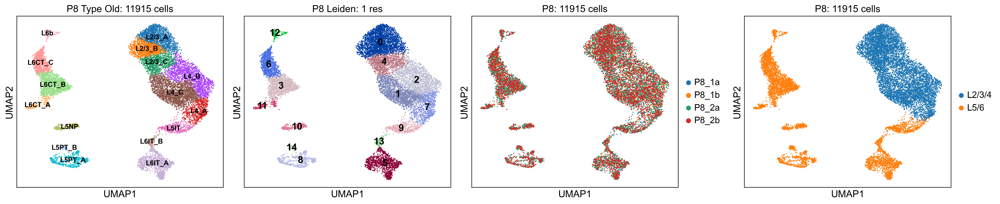

In [14]:
#sc.tl.leiden(adata, resolution=1)
fig, axs = plt.subplots(1, 4, figsize = (20,4), constrained_layout=True)
sc.pl.umap(adata, color='Type', legend_fontsize='10', ax=axs[0], 
           show=False, title='P8 Type Old: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
sc.pl.umap(adata, color='leiden', ax=axs[1], show=False, title='P8 Leiden: ' + str(adata.uns['leiden']['params']['resolution']) + ' res', legend_loc='on data')
sc.pl.umap(adata, color='sample', ax=axs[2], show=False, title='P8: ' + str(adata.shape[0]) + ' cells')
sc.pl.umap(adata, color='layer', ax=axs[3], show=False, title='P8: ' + str(adata.shape[0]) + ' cells')

Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


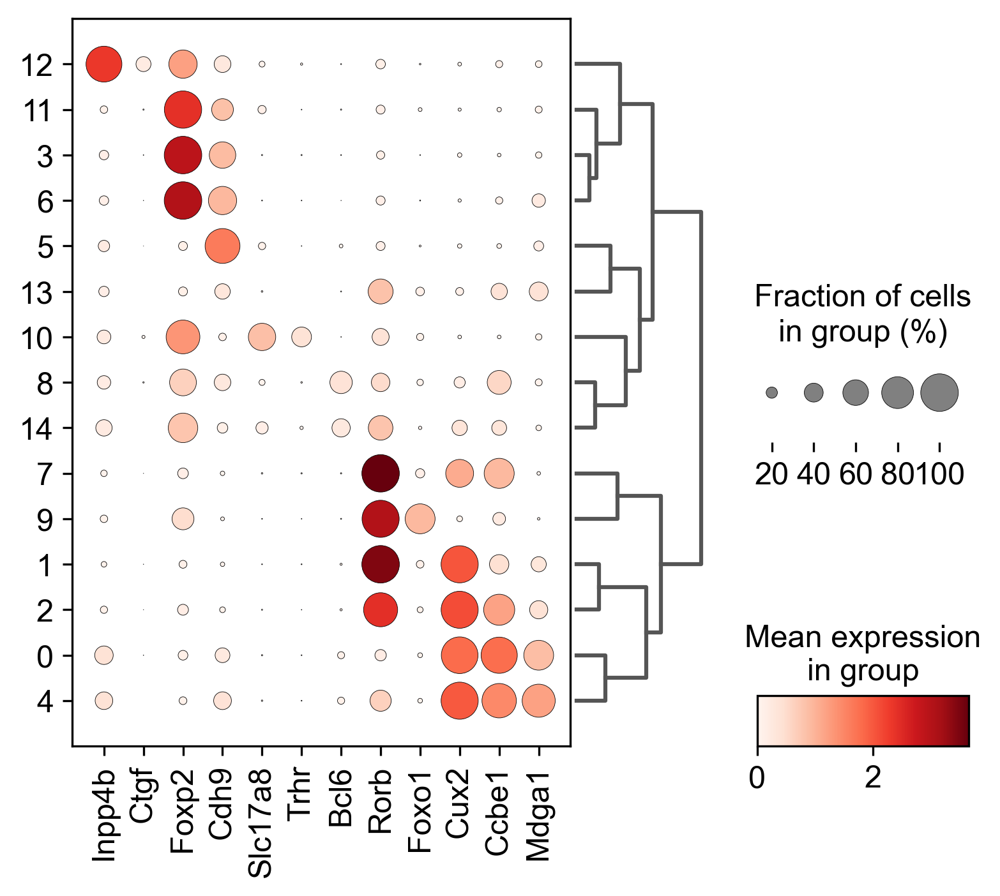

In [8]:
sc.tl.dendrogram(adata, groupby='leiden', use_rep='X_harmony')
bias_markers = ['Inpp4b', 'Ctgf', 'Foxp2', 'Cdh9', 'Slc17a8', 'Trhr', 'Bcl6', 'Rorb', 'Foxo1', 'Cux2', 'Ccbe1',  'Mdga1', ]
sc.pl.dotplot(adata, bias_markers, groupby='leiden', figsize=(6,5), dendrogram=True)

In [16]:
adata.obs.leiden

AAACCCAGTGAGACGT-1-P8_1a-P8-P8_glut-0-0     3
AAACCCATCTGCGATA-1-P8_1a-P8-P8_glut-0-0     2
AAACGCTGTCGTTTCC-1-P8_1a-P8-P8_glut-0-0     6
AAAGAACCAGAGTGAC-1-P8_1a-P8-P8_glut-0-0     1
AAAGAACTCTCACTCG-1-P8_1a-P8-P8_glut-0-0    10
                                           ..
TTTGATCCATGAAGCG-1-P8_2b-P8-P8_glut-0-1     0
TTTGATCTCGACGCGT-1-P8_2b-P8-P8_glut-0-1     0
TTTGGAGAGCATCCCG-1-P8_2b-P8-P8_glut-0-1     4
TTTGGTTGTTCGTAAC-1-P8_2b-P8-P8_glut-0-1     0
TTTGTTGAGCACCCAC-1-P8_2b-P8-P8_glut-0-1     0
Name: leiden, Length: 11914, dtype: category
Categories (15, object): ['0', '1', '2', '3', ..., '11', '12', '13', '14']

In [5]:
Type = ['L2/3_AB', 'L4_A', 'L4_B',
       'L6CT_B', 'L2/3_BC',
        'L6IT_A', 'L6CT_C', 'L4_C',
       'L5PT_A', 'L5IT',  
        'L5NP', 'L6CT_A', 'L6b', 
       'L6IT_B', 'L5PT_B',] 

adata.obs['Type'] = adata.obs['leiden']
a = adata.obs['Type']
adata.obs['Type'] = a.cat.rename_categories(Type).values
#adata.rename_categories(key='cluster', categories=[cluster])

Storing dendrogram info using `.uns["dendrogram_['Type']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


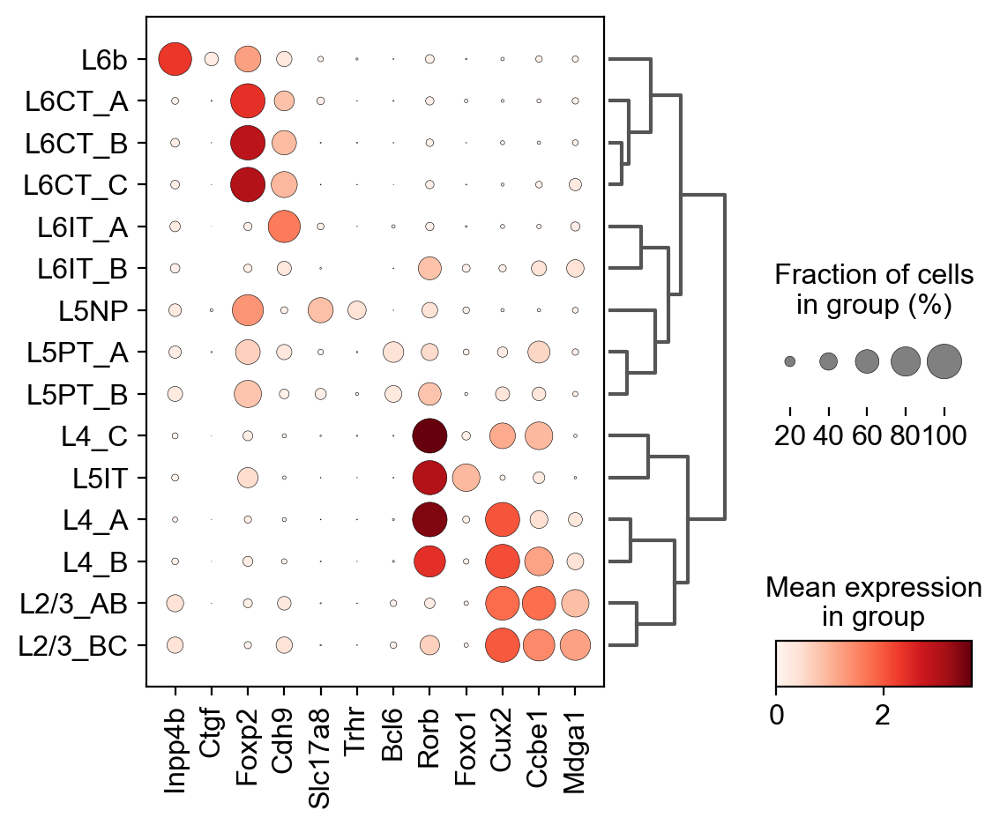

In [6]:
sc.tl.dendrogram(adata, groupby='Type', use_rep='X_harmony')
bias_markers = ['Inpp4b', 'Ctgf', 'Foxp2', 'Cdh9', 'Slc17a8', 'Trhr', 'Bcl6', 'Rorb', 'Foxo1', 'Cux2', 'Ccbe1',  'Mdga1', ]
sc.pl.dotplot(adata, bias_markers, 
              groupby='Type', dendrogram=True, figsize=(6,5))

In [49]:
adata.obs['Subclass'] = adata.obs['Type']
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_1','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_2','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_3','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_A','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_AB','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_B','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('B','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_C','')

In [50]:
adata.obs['Age'] = pd.Categorical(adata.shape[0]*['P8'])

In [12]:
P8_L23 = sc.read_h5ad('P8_L23_mapped_to_P28_L23.h5ad')

In [36]:
print(P8_L23.shape[0], adata[adata.obs.Subclass=='L2/3',:].shape[0])

3384 3384


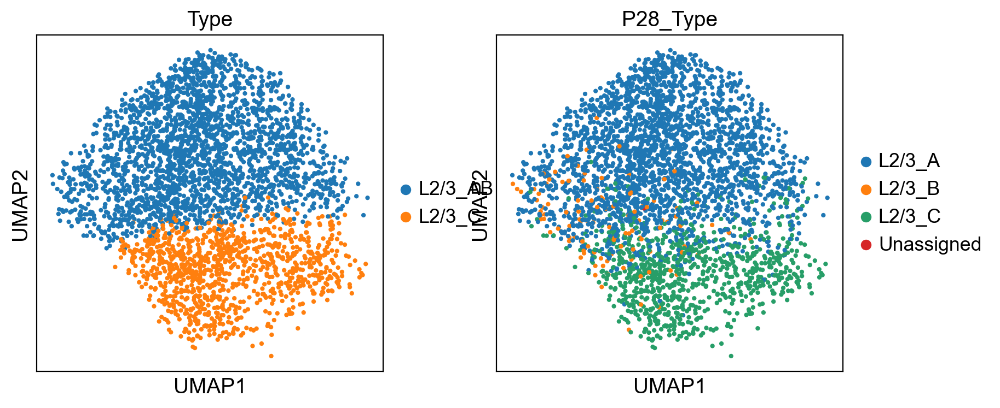

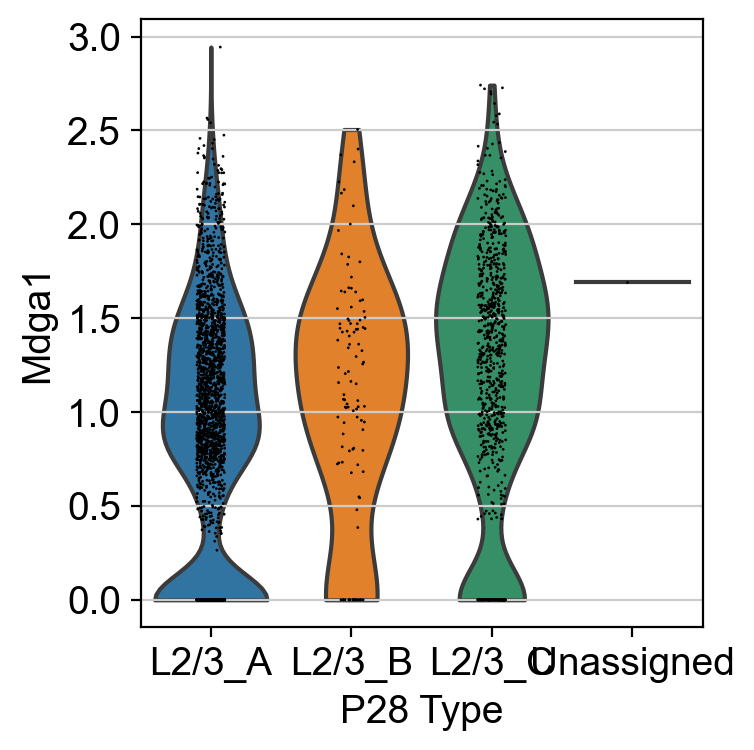

In [37]:
sc.pl.umap(P8_L23, color=['Type', 'P28_Type'])
sc.pl.violin(P8_L23, 'Mdga1', groupby='P28_Type')

In [39]:
adata = adata[adata.obs.Subclass!='L2/3',:]

In [41]:
adata_new = adata.concatenate(P8_L23)
print(adata_new.shape)

(11915, 30869)


In [49]:
P28type = []

for i in range(adata_new.shape[0]):
    
    if (adata_new.obs.Subclass[i] =='L2/3'): 
        P28type.append(adata_new.obs['P28_Type'][i])
    else: 
        P28type.append(adata_new.obs['Type'][i])

In [52]:
adata_new.obs['P28_Type'] = pd.Categorical(P28type)

In [54]:
adata_new = adata_new[adata_new.obs['P28_Type']!='Unassigned',:]

In [58]:
Type = ['L2/3_AB', 'L4_A', 'L4_B',
       'L6CT_B', 'L2/3_BC',
        'L6IT_A', 'L6CT_C', 'L4_C',
       'L5PT_A', 'L5IT',  
        'L5NP', 'L6CT_A', 'L6b', 
       'L6IT_B', 'L5PT_B',] 

adata_new.obs['Type'] = adata_new.obs['leiden']
a = adata_new.obs['Type']
adata_new.obs['Type'] = a.cat.rename_categories(Type).values

Trying to set attribute `.obs` of view, copying.


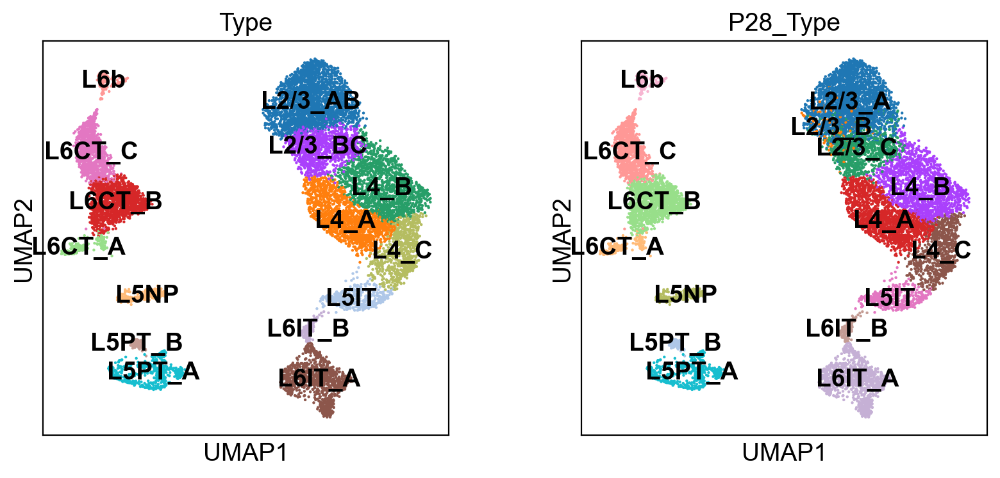

In [65]:
sc.pl.umap(adata_new, color=['Type', 'P28_Type'], legend_loc='on data')

Losing neighbor info here b/c merging 2 objs

In [61]:
#adata.write_h5ad('P8_glut_11212020.h5ad')
#adata.write_h5ad('P8_glut_12022020.h5ad')
adata_new.write_h5ad('P8_glut_02112021.h5ad')

In [40]:
adata = sc.read_h5ad('P8_glut_02112021.h5ad')

## L2/3 at P8

ranking genes


Trying to set attribute `.obs` of view, copying.
... storing 'Subclass' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


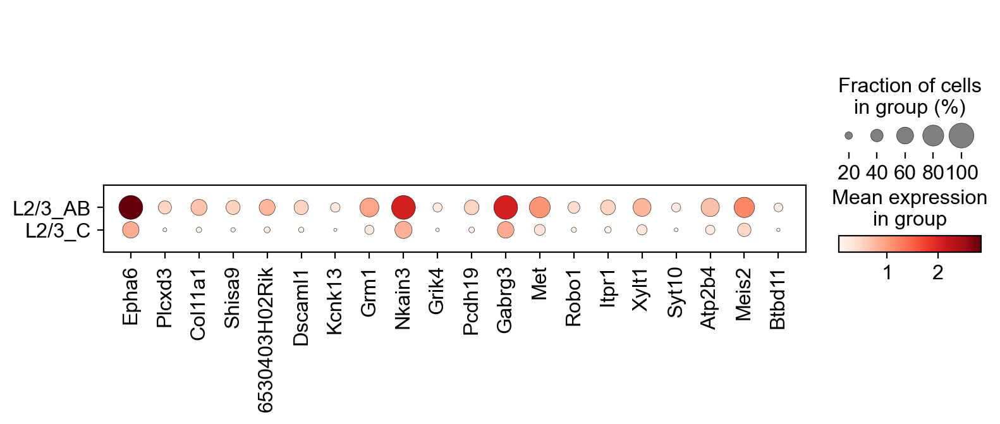

['Epha6', 'Plcxd3', 'Col11a1', 'Shisa9', '6530403H02Rik', 'Dscaml1']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


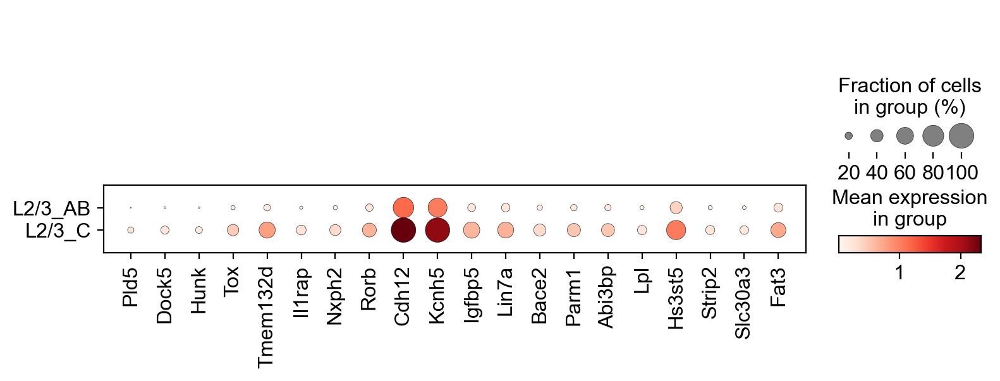

['Pld5', 'Dock5', 'Hunk', 'Tox', 'Tmem132d', 'Il1rap']


In [52]:
adata_23 = adata[adata.obs.Subclass=='L2/3',:]
LFs = []
for i in pd.Series(adata_23.obs.Type.values, dtype='category').values.categories:
    Type = i
    sc.tl.rank_genes_groups(adata_23, groupby='Type', groups=[Type], reference='rest', method='wilcoxon', n_genes=250)
    #wilcGenes23vRest = list(adata_23.uns['rank_genes_groups']['names'].astype([(Type, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    #if ('Malat1' in wilcGenes23vRest): del wilcGenes23vRest[wilcGenes23vRest.index('Malat1')]

    wilcLF8v14 = adata_23.uns['rank_genes_groups']['logfoldchanges'].astype([(Type, '<f8')]).view('<f8') #log fold changes ordered by score

    wilcGenes8v14_s = list(adata_23.uns['rank_genes_groups']['names'].astype([(Type, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    wilcLF8v14_s = adata_23.uns['rank_genes_groups']['logfoldchanges'].astype([(Type, '<f8')]).view('<f8') #numpy array of logfoldchnages to be ordered lowest to highest
    wilcLF8v14_s.sort() #log fold changes from lowest to highest
    wilcGenes8v14 = [] #list of genes ordered by logfold change: low to high
    for i in wilcLF8v14_s:
        gene_idx = np.where(wilcLF8v14 == i)[0][0]
        wilcGenes8v14.append(wilcGenes8v14_s[gene_idx])
    wilcGenes8v14_correct = []
    for i in reversed(wilcGenes8v14):
        wilcGenes8v14_correct.append(i) # #list of genes ordered by logfold change high to low

    sc.pl.dotplot(adata_23, wilcGenes8v14_correct[0:20], groupby='Type')
    print(wilcGenes8v14_correct[0:6])
    LFs.append(wilcLF8v14_s)




## Tuning cluster resolution


In [108]:
#read pre-P28type version that has neighbor info
adata = sc.read_h5ad('P8_glut_02112021.h5ad')

In [50]:
def calculateNCE(labels_true,labels_pred):
    X = labels_true
    Y = labels_pred
    contTable = confusion_matrix(X,Y)[0:len(np.unique(X)), 0:len(np.unique(Y))]
    a = np.sum(contTable, axis = 1)
    b = np.sum(contTable, axis = 0)
    N = np.sum(contTable)
    pij = contTable/N
    pi = a/N
    pj = b/N
    Hyx = np.zeros(contTable.shape)
    for i in range(contTable.shape[0]):
        for j in range(contTable.shape[1]):
          if pij[i,j] == 0:
            Hyx[i,j] = 0
          else:
            Hyx[i,j] = pij[i,j]*np.log10(pij[i,j]/pi[i])
    CE = -np.sum(Hyx)
    Hyi = np.zeros(contTable.shape[1])
    for j in range(contTable.shape[1]):
      if pj[j] == 0:
       Hyi[j] = 0
      else:
        Hyi[j] = pj[j]*np.log10(pj[j])
    Hy = -np.sum(Hyi)
    NCE = CE/Hy
    return NCE

In [109]:
layer = []
for i in range(adata.shape[0]):
    if (adata.obs.Type[i][0:2]=='L2'): layer.append('L2/3')
    elif (adata.obs.Type[i][0:2]=='L4'): layer.append('L4')
    elif (adata.obs.Type[i][0:2]=='L5'): layer.append('L5')
    elif (adata.obs.Type[i][0:2]=='L6'): layer.append('L6')   

adata.obs['layer'] = adata.obs['subclass']
adata.obs['layer'] = pd.Series(layer, dtype='category').values

In [110]:
def_res_leiden_23 = (list(adata[adata.obs.layer=='L2/3',:].obs.leiden.values))
def_res_leiden_4 = (list(adata[adata.obs.layer=='L4',:].obs.leiden.values))

def_res_leiden_5 = (list(adata[adata.obs.layer=='L5',:].obs.leiden.values))
def_res_leiden_6 = (list(adata[adata.obs.layer=='L6',:].obs.leiden.values))

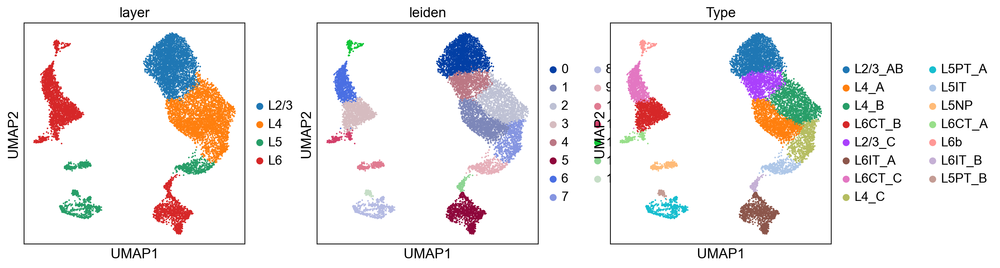

In [111]:
sc.pl.umap(adata, color=['layer','leiden', 'Type'])

In [ ]:
ARI_23 = []
ARI_4 = []

ARI_5 = []
ARI_6 = []

NCE_234 = []
NCE_56 = []

for res in np.arange(1,2.1, 0.1):
    sc.tl.leiden(adata, resolution=res)
    fig, axs = plt.subplots(1, 3, figsize = (13.5,4), constrained_layout=True)
    sc.pl.umap(adata, color='cluster', legend_fontsize='10', ax=axs[0], 
               show=False, title='P8: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
    sc.pl.umap(adata, color='leiden', ax=axs[1], show=False, title='P8 Leiden: ' + str(res) + ' res', legend_loc='on data')
    sc.pl.umap(adata, color='sample', ax=axs[2], show=False, title='P8: ' + str(adata.shape[0]) + ' cells')
    ARI_23.append(adjusted_rand_score(def_res_leiden_23, (list(adata[adata.obs.layer=='L2/3',:].obs.leiden.values))))
    ARI_4.append(adjusted_rand_score(def_res_leiden_4, (list(adata[adata.obs.layer=='L4',:].obs.leiden.values))))

    ARI_5.append(adjusted_rand_score(def_res_leiden_5, (list(adata[adata.obs.layer=='L5',:].obs.leiden.values))))
    ARI_6.append(adjusted_rand_score(def_res_leiden_6, (list(adata[adata.obs.layer=='L6',:].obs.leiden.values))))

    #NCE_234.append(calculateNCE(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    #NCE_56.append(calculateNCE(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

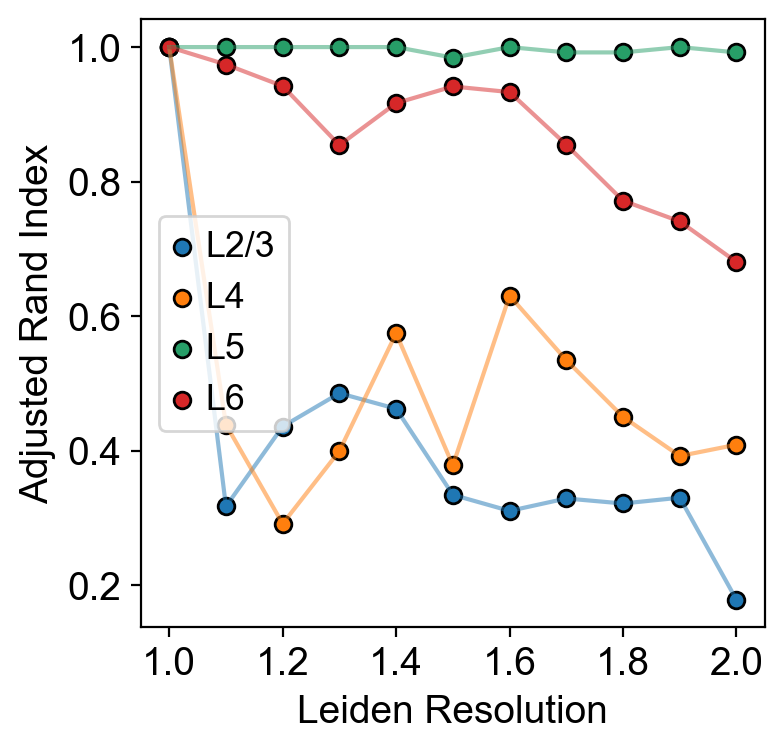

In [87]:
plt.plot(np.arange(1,2.1, 0.1), ARI_23, alpha=0.5)
plt.scatter(np.arange(1,2.1, 0.1), ARI_23, label='L2/3', edgecolor='black')

plt.plot(np.arange(1,2.1, 0.1), ARI_4, alpha=0.5)
plt.scatter(np.arange(1,2.1, 0.1), ARI_4, label='L4', edgecolor='black')

plt.plot(np.arange(1,2.1, 0.1), ARI_5, alpha=0.5)
plt.scatter(np.arange(1,2.1, 0.1), ARI_5, label='L5', edgecolor='black' )

plt.plot(np.arange(1,2.1, 0.1), ARI_6, alpha=0.5)
plt.scatter(np.arange(1,2.1, 0.1), ARI_6, label='L6', edgecolor='black' )


plt.legend()
plt.grid(False)
plt.xlabel('Leiden Resolution')
plt.ylabel('Adjusted Rand Index')
plt.xticks(np.arange(1,2.1, 0.2))
plt.show()


In [72]:
ARIs_P8 = [ARI_23, ARI_4, ARI_5, ARI_6]

In [91]:
P8 = pd.DataFrame(np.transpose(np.array(ARIs_P8)), columns=adata.obs.layer.values.categories)
P8['res'] = np.arange(1,2.1, 0.1)
P8

,L2/3,L4,L5,L6,res
0,1.000000,1.000000,1.000000,1.000000,1.0
1,0.317397,0.439059,1.000000,0.974110,1.1
2,0.436185,0.291634,1.000000,0.942051,1.2
3,0.485652,0.399820,1.000000,0.854237,1.3
4,0.462573,0.574615,1.000000,0.916674,1.4
5,0.334616,0.378321,0.984307,0.941490,1.5
6,0.310770,0.630529,1.000000,0.933143,1.6
7,0.329209,0.534731,0.992071,0.854898,1.7
8,0.321785,0.450505,0.992071,0.771744,1.8
9,0.330391,0.392329,1.000000,0.740964,1.9


In [269]:
ARI_all = pd.concat([P8, P14, P17, P21, P28, P38])

In [292]:
ARI_all.to_excel('ARIs.xlsx')

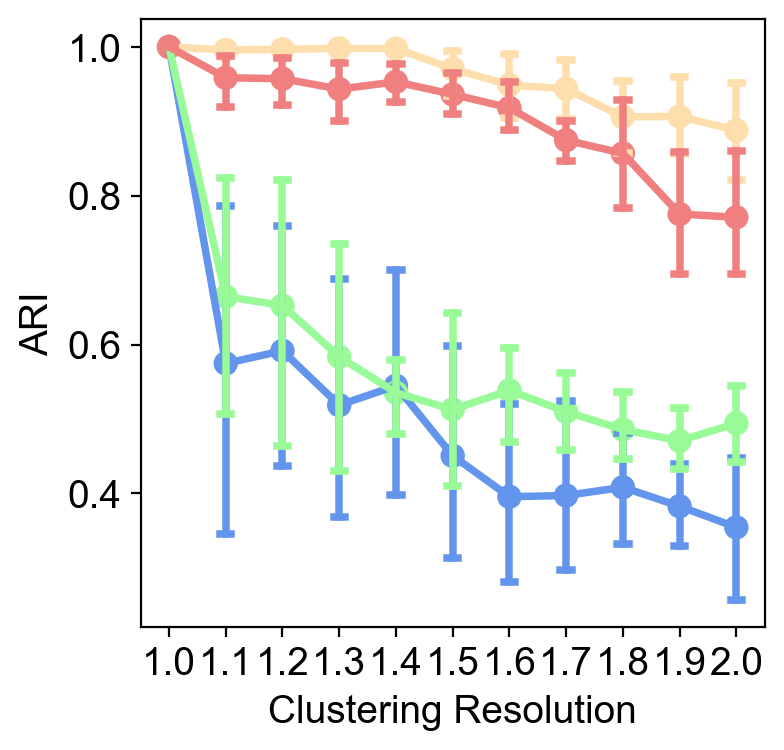

In [290]:
a=sns.pointplot(hi, y="L2/3", data=ARI_all,capsize=.2, color='#6495ed',)
b=sns.pointplot(hi, y="L4", data=ARI_all,capsize=.2, color='#98fb98')
c=sns.pointplot(hi, y="L5", data=ARI_all,capsize=.2, color='#ffdead')
d=sns.pointplot(hi, y="L6", data=ARI_all,capsize=.2, color='#f08080')


plt.grid(False)
#plt.xticks(np.arange(1,2.1, 0.2))

plt.ylabel('ARI')
plt.xlabel('Clustering Resolution')
#plt.legend([a,b,c,d], ['u','v','u+v','e3'])


# P14

In [4]:
adata = sc.read_h5ad('P14_glut08292020.h5ad')
adata

AnnData object with n_obs × n_vars = 21257 × 30869
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'sample', 'Age', 'subclass'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'cluster_colors', "dendrogram_['cluster']", 'dendrogram_cluster', 'dendrogram_leiden', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [16]:
del adata.obsp
del adata.varm
del adata.obsm
del adata.uns
adata

AnnData object with n_obs × n_vars = 21222 × 30869
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'sample', 'Age', 'subclass', 'layer'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'

Number above may change after removing bad clusters from analysis below

In [17]:
adata.X = adata.raw.X.A
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5) #HVGs


sc.pp.scale(adata, max_value=10) #scale
sc.tl.pca(adata, svd_solver='arpack') #run PCA

Z = harmonize(adata.obsm['X_pca'], adata.obs, batch_key = 'sample')
adata.obsm['X_harmony'] = Z

sc.pp.neighbors(adata, n_neighbors=25, use_rep='X_harmony')

#sc.pp.neighbors(adata, n_neighbors=25)
#bbknn(adata, batch_key='sample',neighbors_within_batch =6 ) #doesn't work
sc.tl.leiden(adata)
sc.tl.umap(adata)

	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
Reach convergence after 3 iteration(s).


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../../opt/anaconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


#super small, diffuse expression, no correspondence to former clusters
#adata = adata[adata.obs['leiden']!='12',:]
#adata = adata[adata.obs['leiden']!='17',:]

adata = adata[adata.obs['leiden']!='16',:]

In [18]:
layer = []
for i in range(adata.shape[0]):
    if (adata.obs.cluster[i][0:2]=='L2'): layer.append('L2/3/4')
    elif (adata.obs.cluster[i][0:2]=='L4'): layer.append('L2/3/4')
    elif (adata.obs.cluster[i][0:2]=='L5'): layer.append('L5/6')
    elif (adata.obs.cluster[i][0:2]=='L6'): layer.append('L5/6')   

adata.obs['layer'] = adata.obs['subclass']
adata.obs['layer'] = pd.Series(layer, dtype='category').values

## Final clustering P14

In [3]:
#adata = sc.read_h5ad('P14_glut_11212020.h5ad')
#adata = sc.read_h5ad('P14_glut_12022020.h5ad')
adata = sc.read_h5ad('P14_glut_02112021.h5ad')

In [61]:
sc.tl.leiden(adata, resolution=0.90)

running Leiden clustering
    finished: found 15 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:08)


<AxesSubplot:title={'center':'P14: 21222 cells'}, xlabel='UMAP1', ylabel='UMAP2'>

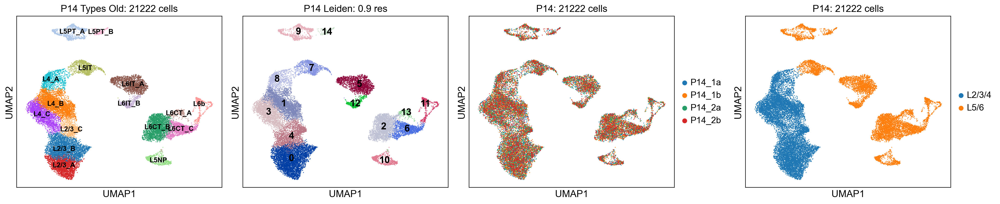

In [62]:
#sc.tl.leiden(adata)
fig, axs = plt.subplots(1, 4, figsize = (20,4), constrained_layout=True)
sc.pl.umap(adata, color='Type', legend_fontsize='10', ax=axs[0], 
           show=False, title='P14 Types Old: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
sc.pl.umap(adata, color='leiden', ax=axs[1], show=False, title='P14 Leiden: ' + str(adata.uns['leiden']['params']['resolution']) + ' res', legend_loc='on data')
sc.pl.umap(adata, color='sample', ax=axs[2], show=False, title='P14: ' + str(adata.shape[0]) + ' cells')
sc.pl.umap(adata, color='layer', ax=axs[3], show=False, title='P14: ' + str(adata.shape[0]) + ' cells')

Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


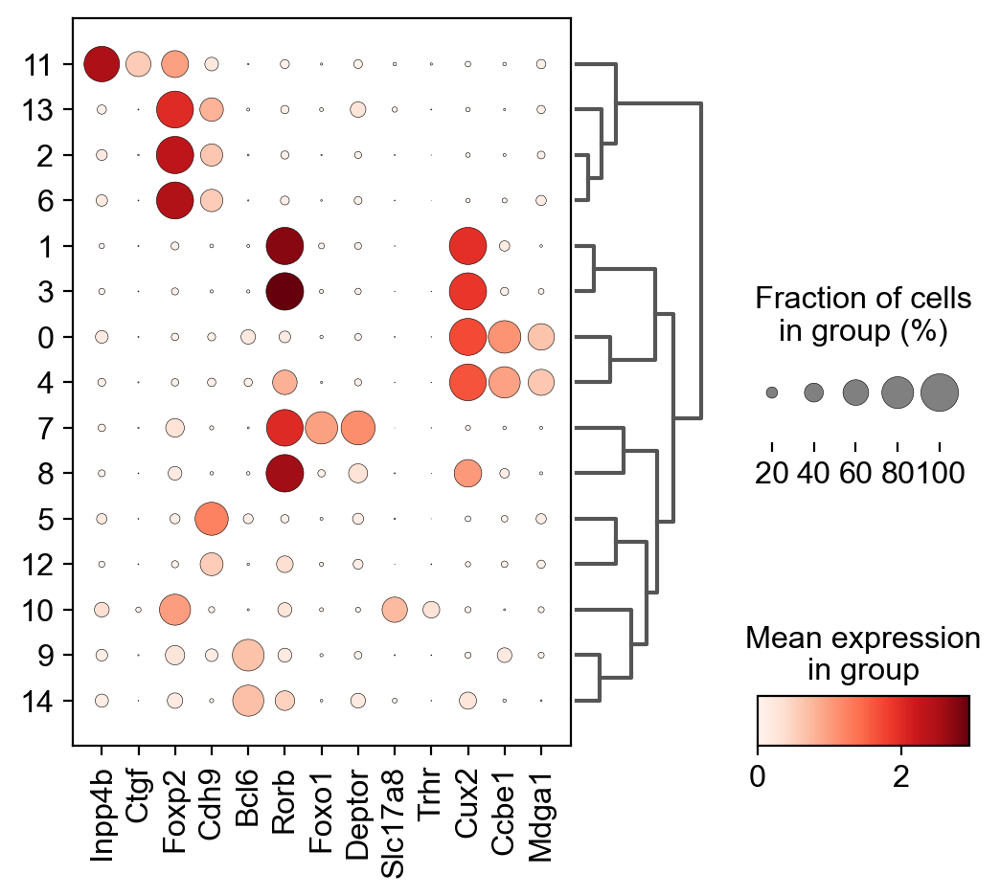

In [65]:
sc.tl.dendrogram(adata, groupby='leiden', use_rep='X_harmony')
bias_markers = ['Inpp4b', 'Ctgf', 'Foxp2', 'Cdh9', 'Bcl6', 'Cux2', 'Ccbe1',  'Mdga1', 'Rorb', 
                'Foxo1',  'Deptor', 'Slc17a8', 'Trhr', ]
sc.pl.dotplot(adata, bias_markers, 
              groupby='leiden', figsize=(6,5), dendrogram=True)

In [69]:
Type = ['L2/3_AB','L4_B', 
        'L6CT_B', 'L4_A', 'L2/3_BC', 'L6IT_A', 'L6CT_C',
       'L5IT', 'L4_C', 'L5PT_A', 
        'L5NP', 'L6b', 
       'L6IT_B', 'L6CT_A', 'L5PT_B',] 

adata.obs['Type'] = adata.obs['leiden']
a = adata.obs['Type']
adata.obs['Type'] = a.cat.rename_categories(Type).values
#adata.rename_categories(key='cluster', categories=[cluster])

Storing dendrogram info using `.uns["dendrogram_['Type']"]`


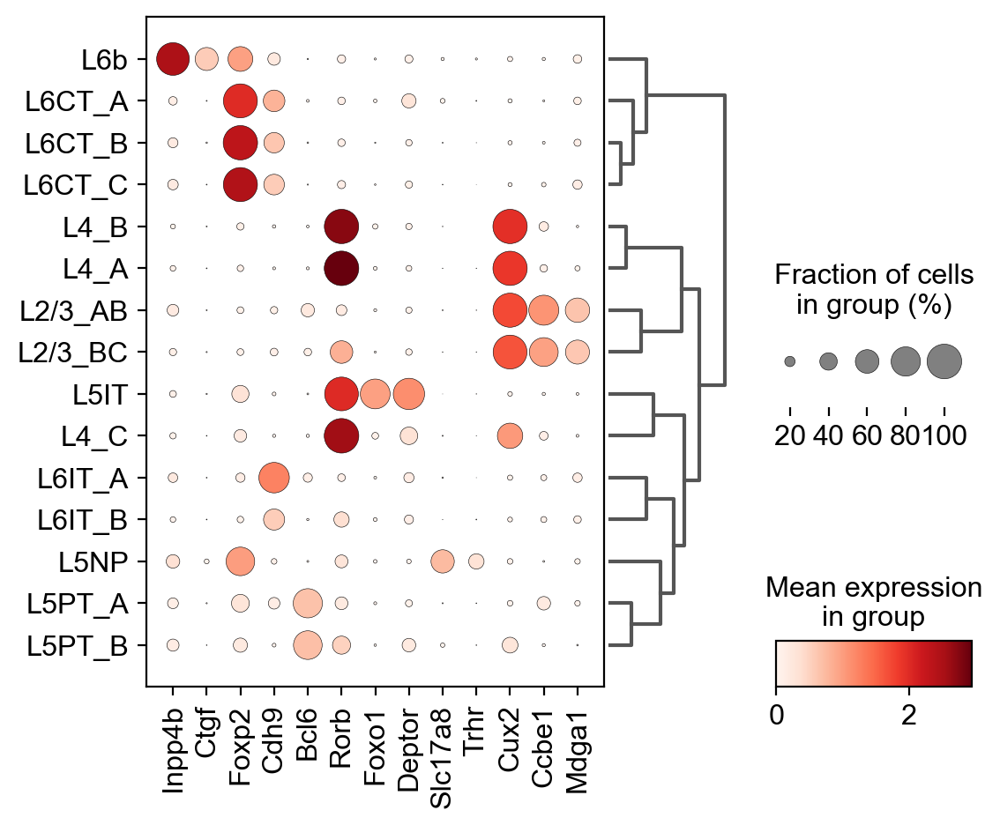

In [71]:
sc.tl.dendrogram(adata, groupby='Type', use_rep='X_harmony')
bias_markers = ['Inpp4b', 'Ctgf', 'Foxp2', 'Cdh9', 'Bcl6', 'Rorb', 'Foxo1', 'Deptor', 'Slc17a8', 'Trhr','Cux2', 'Ccbe1',  'Mdga1', ]
sc.pl.dotplot(adata, bias_markers, 
              groupby='Type', dendrogram=True, figsize=(6,5))

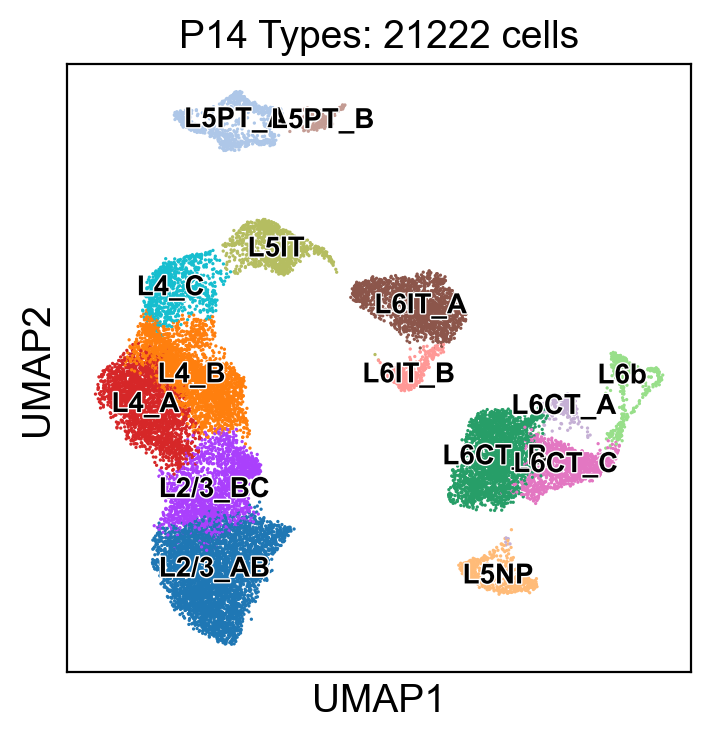

In [72]:
sc.pl.umap(adata, color='Type', legend_fontsize='10',
           title='P14 Types: ' + str(adata.shape[0]) + ' cells', legend_loc='on data', 
           legend_fontoutline=1)

In [4]:
P14_L23 = sc.read_h5ad('P14_L23_mapped_to_P28_L23.h5ad')

In [5]:
print(P14_L23.shape[0], adata[adata.obs.Subclass=='L2/3',:].shape[0])

6249 0


In [6]:
#adata = adata[adata.obs.Subclass!='L2/3',:]

adata_new = adata.concatenate(P14_L23)
print(adata_new.shape)

P28type = []

for i in range(adata_new.shape[0]):
    
    if (adata_new.obs.Subclass[i] =='L2/3'): 
        P28type.append(adata_new.obs['P28_Type'][i])
    else: 
        P28type.append(adata_new.obs['Type'][i])

adata_new.obs['P28_Type'] = pd.Categorical(P28type)

adata_new = adata_new[adata_new.obs['P28_Type']!='Unassigned',:]

(21222, 30869)


In [9]:
Type = ['L2/3_AB','L4_B', 
        'L6CT_B', 'L4_A', 'L2/3_BC', 'L6IT_A', 'L6CT_C',
       'L5IT', 'L4_C', 'L5PT_A', 
        'L5NP', 'L6b', 
       'L6IT_B', 'L6CT_A', 'L5PT_B',] 

adata_new.obs['Type'] = adata_new.obs['leiden']
a = adata_new.obs['Type']
adata_new.obs['Type'] = a.cat.rename_categories(Type).values

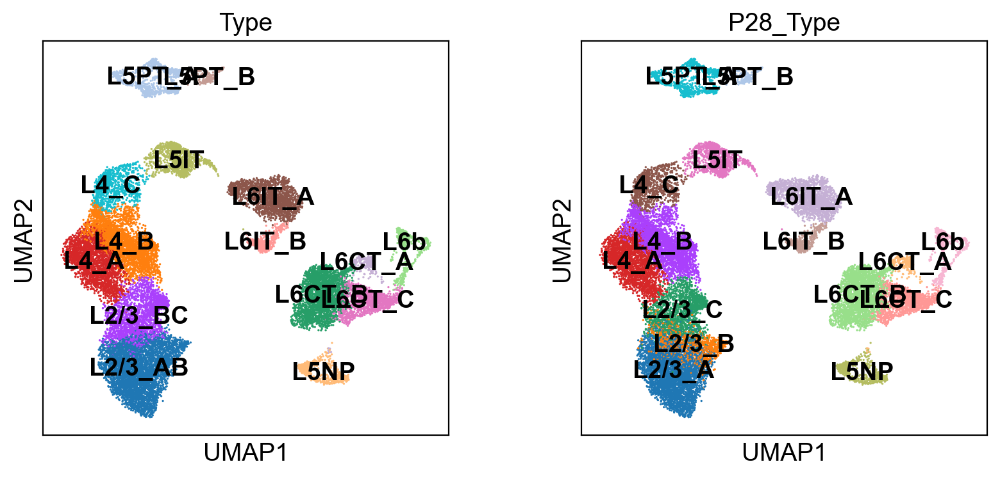

In [10]:
sc.pl.umap(adata_new, color=['Type', 'P28_Type'], legend_loc='on data')

In [ ]:
#subclasses
adata.obs['Subclass'] = adata.obs['Type']
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_1','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_2','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_3','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_AB','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_A','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_B','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_C','')
adata.obs['Subclass'] = pd.Categorical(adata.obs['Subclass'].values)

In [11]:
adata_new

AnnData object with n_obs × n_vars = 21220 × 30869
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'sample', 'Age', 'subclass', 'layer', 'Type', 'Subclass', 'P28_Type'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'mean', 'std', 'dispersions-0', 'dispersions_norm-0', 'dispersions-1', 'dispersions_norm-1'
    uns: 'Type_colors', 'P28_Type_colors'
    obsm: 'X_harmony', 'X_pca', 'X_umap'

In [12]:
#adata.write_h5ad('P14_glut_11212020.h5ad')
#adata.write_h5ad('P14_glut_12022020.h5ad')
adata_new.write_h5ad('P14_glut_02112021.h5ad')

## L2/3 at P14

ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
Trying to set attribute `.uns` of view, copying.


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:13)


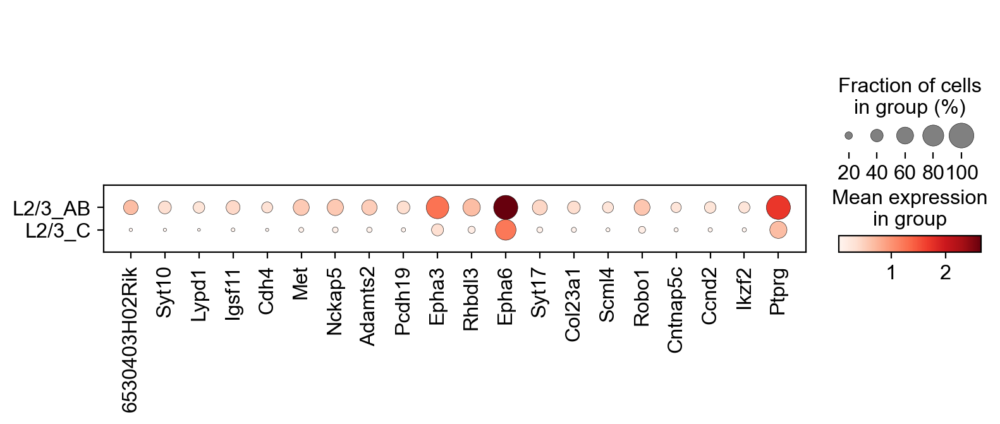

['6530403H02Rik', 'Syt10', 'Lypd1', 'Igsf11', 'Cdh4', 'Met']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:12)


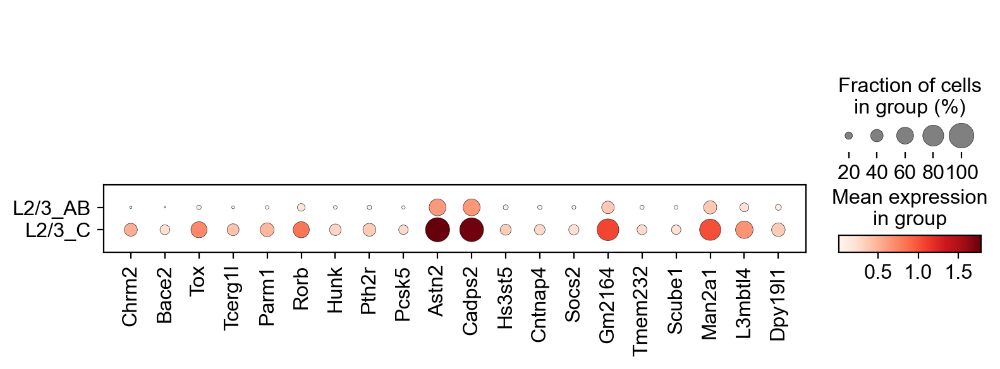

['Chrm2', 'Bace2', 'Tox', 'Tcerg1l', 'Parm1', 'Rorb']


In [78]:
adata_23 = adata[adata.obs.Subclass=='L2/3',:]
LFs = []
for i in adata_23.obs.Type.values.categories:
    Type = i
    sc.tl.rank_genes_groups(adata_23, groupby='Type', groups=[Type], reference='rest', method='wilcoxon', n_genes=250)
    #wilcGenes23vRest = list(adata_23.uns['rank_genes_groups']['names'].astype([(Type, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    #if ('Malat1' in wilcGenes23vRest): del wilcGenes23vRest[wilcGenes23vRest.index('Malat1')]

    wilcLF8v14 = adata_23.uns['rank_genes_groups']['logfoldchanges'].astype([(Type, '<f8')]).view('<f8') #log fold changes ordered by score

    wilcGenes8v14_s = list(adata_23.uns['rank_genes_groups']['names'].astype([(Type, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    wilcLF8v14_s = adata_23.uns['rank_genes_groups']['logfoldchanges'].astype([(Type, '<f8')]).view('<f8') #numpy array of logfoldchnages to be ordered lowest to highest
    wilcLF8v14_s.sort() #log fold changes from lowest to highest
    wilcGenes8v14 = [] #list of genes ordered by logfold change: low to high
    for i in wilcLF8v14_s:
        gene_idx = np.where(wilcLF8v14 == i)[0][0]
        wilcGenes8v14.append(wilcGenes8v14_s[gene_idx])
    wilcGenes8v14_correct = []
    for i in reversed(wilcGenes8v14):
        wilcGenes8v14_correct.append(i) # #list of genes ordered by logfold change high to low

    sc.pl.dotplot(adata_23, wilcGenes8v14_correct[0:20], groupby='Type')
    print(wilcGenes8v14_correct[0:6])
    LFs.append(wilcLF8v14_s)

## Tuning cluster resolution P14


**read in pre-P28type version**

In [40]:
def_res_leiden_234 = (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))
def_res_leiden_56 = (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [ ]:
ARI_234 = []
ARI_56 = []

NCE_234 = []
NCE_56 = []

for res in np.arange(1,2.1, 0.1):
    sc.tl.leiden(adata, resolution=res)
    fig, axs = plt.subplots(1, 3, figsize = (13.5,4), constrained_layout=True)
    sc.pl.umap(adata, color='cluster', legend_fontsize='10', ax=axs[0], 
               show=False, title='P14: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
    sc.pl.umap(adata, color='leiden', ax=axs[1], show=False, title='P14 Leiden: ' + str(res) + ' res', legend_loc='on data')
    sc.pl.umap(adata, color='sample', ax=axs[2], show=False, title='P14: ' + str(adata.shape[0]) + ' cells')
    ARI_234.append(adjusted_rand_score(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    ARI_56.append(adjusted_rand_score(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

    NCE_234.append(calculateNCE(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    NCE_56.append(calculateNCE(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

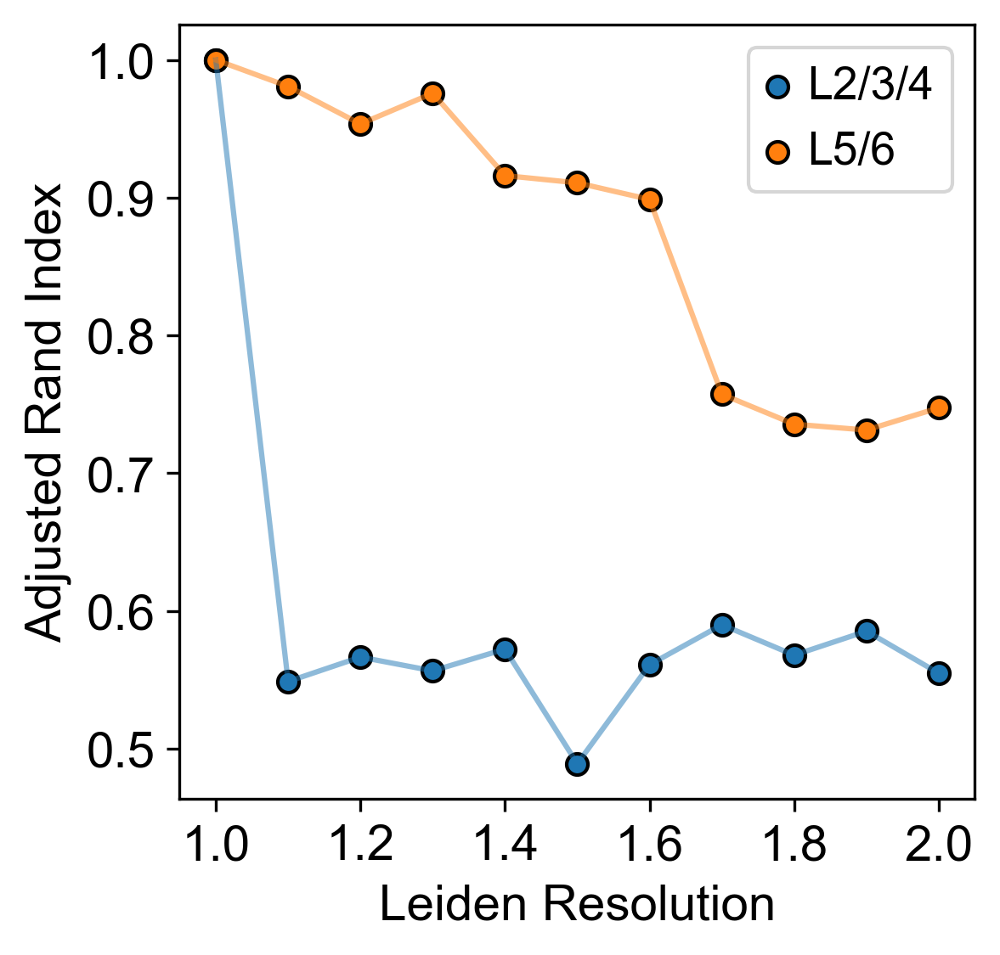

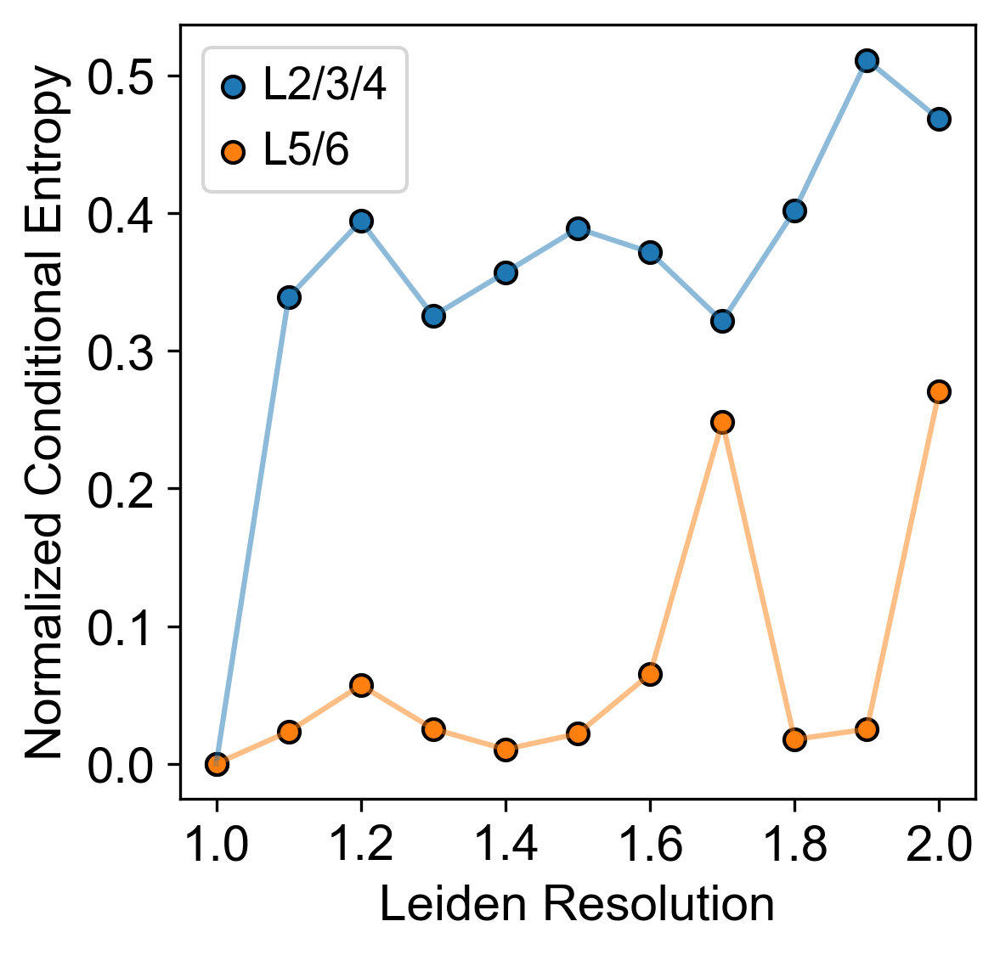

In [42]:
plt.plot(np.arange(1,2.1, 0.1), ARI_234, alpha=0.5)
plt.scatter(np.arange(1,2.1, 0.1), ARI_234, label='L2/3/4', edgecolor='black')

plt.plot(np.arange(1,2.1, 0.1), ARI_56, alpha=0.5)
plt.scatter(np.arange(1,2.1, 0.1), ARI_56, label='L5/6', edgecolor='black' )


plt.legend()
plt.grid(False)
plt.xlabel('Leiden Resolution')
plt.ylabel('Adjusted Rand Index')
plt.xticks(np.arange(1,2.1, 0.2))
plt.show()

plt.plot(np.arange(1,2.1, 0.1), NCE_234, alpha=0.5)
plt.scatter(np.arange(1,2.1, 0.1), NCE_234, label='L2/3/4', edgecolor='black')

plt.plot(np.arange(1,2.1, 0.1), NCE_56, alpha=0.5)
plt.scatter(np.arange(1,2.1, 0.1), NCE_56, label='L5/6', edgecolor='black' )


plt.legend()
plt.grid(False)
plt.xlabel('Leiden Resolution')
plt.ylabel('Normalized Conditional Entropy')
plt.xticks(np.arange(1,2.1, 0.2))
plt.show()

In [144]:
adata = sc.read_h5ad('P14_glut_02112021.h5ad')

In [148]:
layer = []
for i in range(adata.shape[0]):
    if (adata.obs.Type[i][0:2]=='L2'): layer.append('L2/3')
    elif (adata.obs.Type[i][0:2]=='L4'): layer.append('L4')
    elif (adata.obs.Type[i][0:2]=='L5'): layer.append('L5')
    elif (adata.obs.Type[i][0:2]=='L6'): layer.append('L6')   

adata.obs['layer'] = pd.Series(layer, dtype='category').values

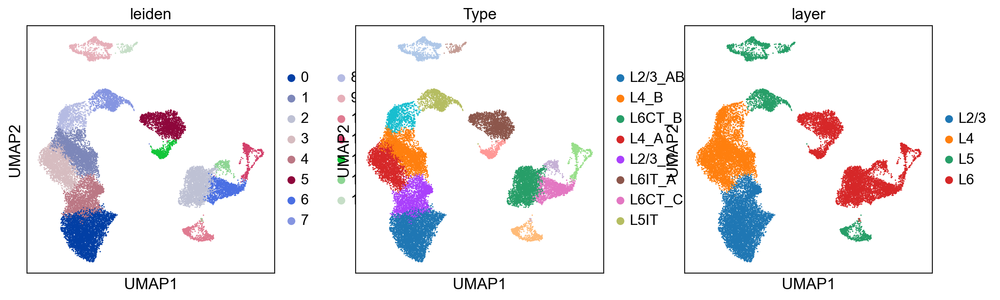

In [105]:
sc.pl.umap(adata, color=['leiden', 'Type', 'layer'])

In [ ]:
def_res_leiden_23 = (list(adata[adata.obs.layer=='L2/3',:].obs.leiden.values))
def_res_leiden_4 = (list(adata[adata.obs.layer=='L4',:].obs.leiden.values))

def_res_leiden_5 = (list(adata[adata.obs.layer=='L5',:].obs.leiden.values))
def_res_leiden_6 = (list(adata[adata.obs.layer=='L6',:].obs.leiden.values))

ARI_23 = []
ARI_4 = []

ARI_5 = []
ARI_6 = []

NCE_234 = []
NCE_56 = []

for res in np.arange(0.9,2.1, 0.1):
    sc.tl.leiden(adata, resolution=res)
    fig, axs = plt.subplots(1, 3, figsize = (13.5,4), constrained_layout=True)
    sc.pl.umap(adata, color='cluster', legend_fontsize='10', ax=axs[0], 
               show=False, title='P14: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
    sc.pl.umap(adata, color='leiden', ax=axs[1], show=False, title='P14 Leiden: ' + str(res) + ' res', legend_loc='on data')
    sc.pl.umap(adata, color='sample', ax=axs[2], show=False, title='P14: ' + str(adata.shape[0]) + ' cells')
    ARI_23.append(adjusted_rand_score(def_res_leiden_23, (list(adata[adata.obs.layer=='L2/3',:].obs.leiden.values))))
    ARI_4.append(adjusted_rand_score(def_res_leiden_4, (list(adata[adata.obs.layer=='L4',:].obs.leiden.values))))

    ARI_5.append(adjusted_rand_score(def_res_leiden_5, (list(adata[adata.obs.layer=='L5',:].obs.leiden.values))))
    ARI_6.append(adjusted_rand_score(def_res_leiden_6, (list(adata[adata.obs.layer=='L6',:].obs.leiden.values))))

    #NCE_234.append(calculateNCE(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    #NCE_56.append(calculateNCE(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

ARIs_P14 = [ARI_23, ARI_4, ARI_5, ARI_6]

P14 = pd.DataFrame(np.transpose(np.array(ARIs_P14)), columns=adata.obs.layer.values.categories)
P14['res'] = np.arange(0.9,2.1, 0.1)
P14

In [150]:
P14 = pd.DataFrame(np.transpose(np.array(ARIs_P14)), columns=adata.obs.layer.values.categories)
P14['res'] = np.arange(1,2.2, 0.1)
P14

,L2/3,L4,L5,L6,res
0,1.000000,1.000000,1.000000,1.000000,1.0
1,0.207443,0.753893,0.997759,0.967085,1.1
2,0.309700,0.564637,0.997759,0.989980,1.2
3,0.327088,0.424963,0.997759,0.937748,1.3
4,0.323456,0.562084,1.000000,0.964367,1.4
5,0.208724,0.416140,0.886322,0.898872,1.5
6,0.249764,0.430447,0.883889,0.898437,1.6
7,0.276239,0.432751,0.883889,0.877971,1.7
8,0.272240,0.464438,0.883889,0.711462,1.8
9,0.283787,0.505745,0.881459,0.658152,1.9


In [153]:
P14 = P14[P14['res']<2.1]

In [154]:
P14

,L2/3,L4,L5,L6,res
0,1.000000,1.000000,1.000000,1.000000,1.0
1,0.207443,0.753893,0.997759,0.967085,1.1
2,0.309700,0.564637,0.997759,0.989980,1.2
3,0.327088,0.424963,0.997759,0.937748,1.3
4,0.323456,0.562084,1.000000,0.964367,1.4
5,0.208724,0.416140,0.886322,0.898872,1.5
6,0.249764,0.430447,0.883889,0.898437,1.6
7,0.276239,0.432751,0.883889,0.877971,1.7
8,0.272240,0.464438,0.883889,0.711462,1.8
9,0.283787,0.505745,0.881459,0.658152,1.9


# P17

In [45]:
adata = sc.read_h5ad('P17_glut08122020.h5ad')
adata

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/compat/__init__.py:161: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,
/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/compat/__init__.py:161: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  FutureWarning,


AnnData object with n_obs × n_vars = 18038 × 30869
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'sample', 'Age', 'subclass'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'cluster_colors', 'dendrogram_cluster', 'dendrogram_leiden', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [46]:
del adata.obsp
del adata.varm
del adata.obsm
del adata.uns
adata

AnnData object with n_obs × n_vars = 18038 × 30869
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'sample', 'Age', 'subclass'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'

In [53]:
adata.X = adata.raw.X.A
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5) #HVGs


sc.pp.scale(adata, max_value=10) #scale
sc.tl.pca(adata, svd_solver='arpack') #run PCA

Z = harmonize(adata.obsm['X_pca'], adata.obs, batch_key = 'sample')
adata.obsm['X_harmony'] = Z

sc.pp.neighbors(adata, n_neighbors=25, use_rep='X_harmony')

#sc.pp.neighbors(adata, n_neighbors=25)
#bbknn(adata, batch_key='sample',neighbors_within_batch =6 ) #doesn't work
sc.tl.leiden(adata)
sc.tl.umap(adata)

extracting highly variable genes
    finished (0:00:06)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:06)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
Reach convergence after 6 iteration(s).
computing neighbors


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../../opt/anaconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:08)
running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:12)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)


#super small, diffuse expression, no correspondence to former clusters
adata = adata[adata.obs['leiden']!='16',:]

In [48]:
layer = []
for i in range(adata.shape[0]):
    if (adata.obs.cluster[i][0:2]=='L2'): layer.append('L2/3/4')
    elif (adata.obs.cluster[i][0:2]=='L4'): layer.append('L2/3/4')
    elif (adata.obs.cluster[i][0:2]=='L5'): layer.append('L5/6')
    elif (adata.obs.cluster[i][0:2]=='L6'): layer.append('L5/6')   

adata.obs['layer'] = adata.obs['subclass']
adata.obs['layer'] = pd.Series(layer, dtype='category').values

## Final clustering P17

In [81]:
#adata = sc.read_h5ad('P17_glut_11222020.h5ad')
adata = sc.read_h5ad('P17_glut_12022020.h5ad')

In [9]:
adata.obs['leiden'].values.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15'],
      dtype='object')

In [82]:
Type = ['L2/3_B', 
       'L4_A', 'L6CT_B', 'L6IT_A',
       'L2/3_C', 'L4_B', 'L6CT_C', 
       'L2/3_A', 'L5IT', 'L4_C',
       'L5PT_A', 'L5NP', 'L6IT_B',
       'L6b', 'L6CT_A', 'L5PT_B'] 

adata.obs['Type'] = adata.obs['leiden']
a = adata.obs['Type']
adata.obs['Type'] = a.cat.rename_categories(Type).values
#adata.rename_categories(key='cluster', categories=[cluster])

<AxesSubplot:title={'center':'P17: 17940 cells'}, xlabel='UMAP1', ylabel='UMAP2'>

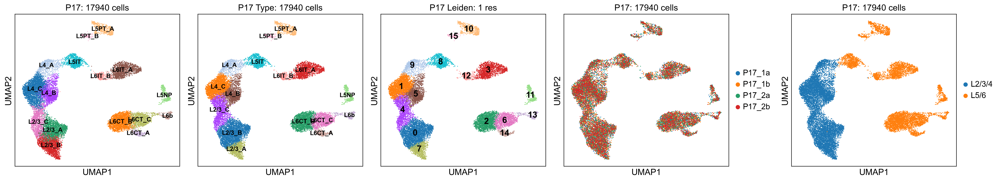

In [12]:
#sc.tl.leiden(adata)
fig, axs = plt.subplots(1, 5, figsize = (22.5,4), constrained_layout=True)
sc.pl.umap(adata, color='cluster', legend_fontsize='10', ax=axs[0], 
           show=False, title='P17: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
sc.pl.umap(adata, color='Type', legend_fontsize='10', ax=axs[1], 
           show=False, title='P17 Type: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
sc.pl.umap(adata, color='leiden', ax=axs[2], show=False, title='P17 Leiden: ' + str(adata.uns['leiden']['params']['resolution']) + ' res', legend_loc='on data')
sc.pl.umap(adata, color='sample', ax=axs[3], show=False, title='P17: ' + str(adata.shape[0]) + ' cells')
sc.pl.umap(adata, color='layer', ax=axs[4], show=False, title='P17: ' + str(adata.shape[0]) + ' cells')

In [55]:
sc.tl.dendrogram(adata, groupby='leiden', use_rep='X_harmony')

Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


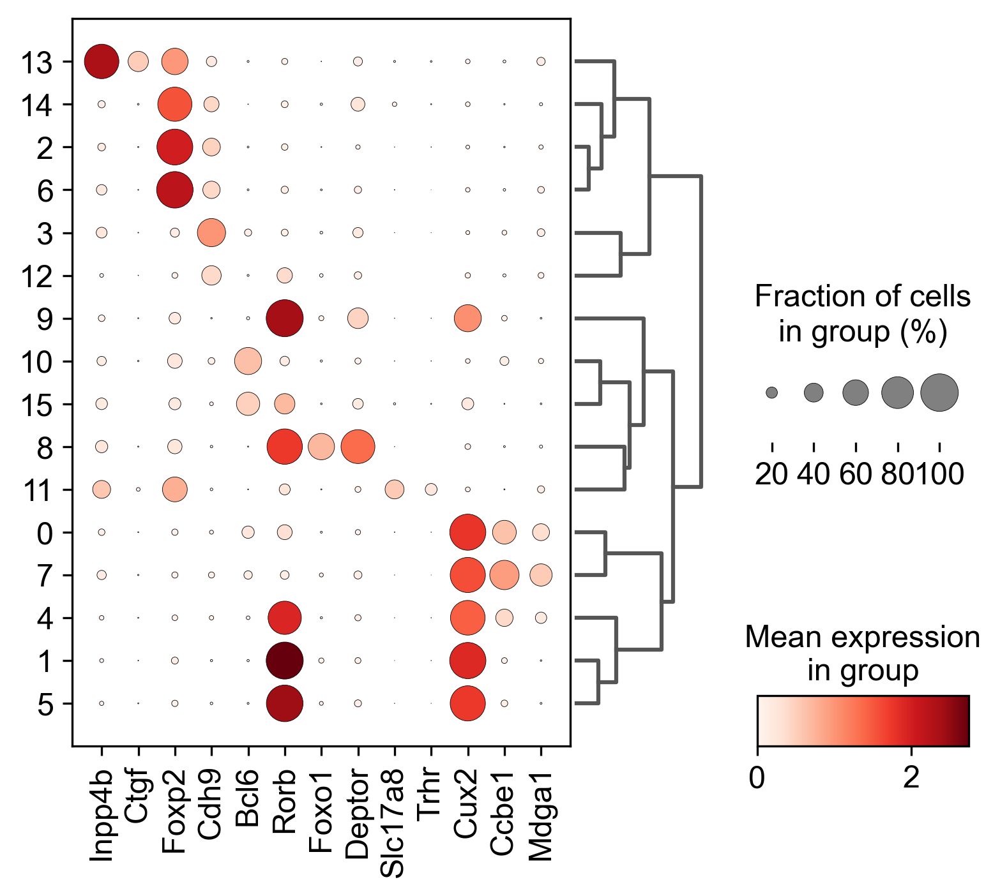

In [56]:
bias_markers = ['Inpp4b', 'Ctgf', 'Foxp2', 'Cdh9', 'Bcl6', 'Rorb', 'Foxo1', 'Deptor', 'Slc17a8', 'Trhr','Cux2', 'Ccbe1',  'Mdga1', ]
sc.pl.dotplot(adata, bias_markers, 
              groupby='leiden', dendrogram=True, figsize=(6,5))

In [40]:
adata.obs['Subclass'] = adata.obs['Type']
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_1','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_2','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_3','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_A','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_B','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_C','')

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


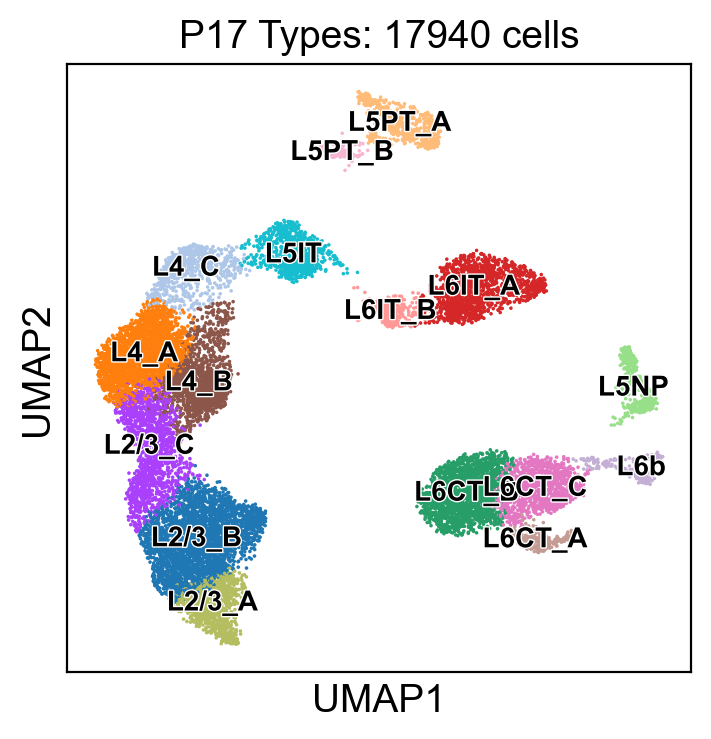

In [83]:
sc.pl.umap(adata, color='Type', legend_fontsize='10',
           title='P17 Types: ' + str(adata.shape[0]) + ' cells', legend_loc='on data', 
           legend_fontoutline=1)

In [85]:
adata.write_h5ad('P17_glut_12022020.h5ad')

## L2/3 at P17

ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
Trying to set attribute `.uns` of view, copying.


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:11)


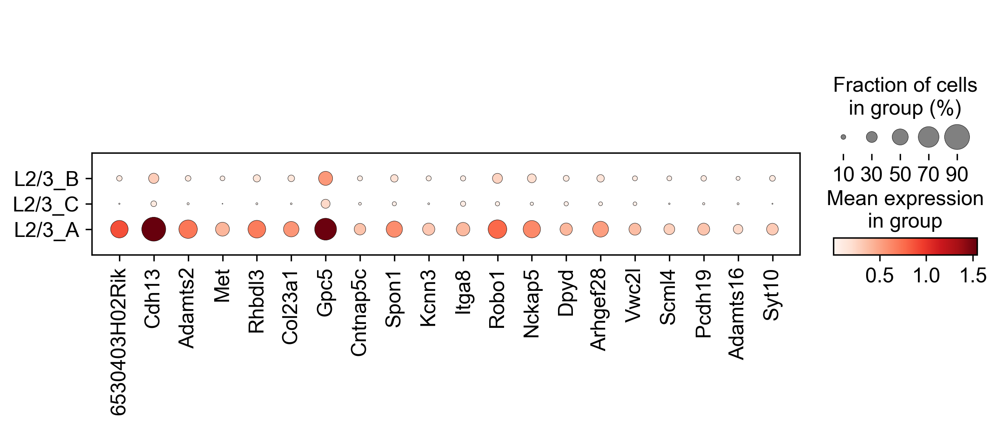

['6530403H02Rik', 'Cdh13', 'Adamts2', 'Met', 'Rhbdl3', 'Col23a1']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:11)


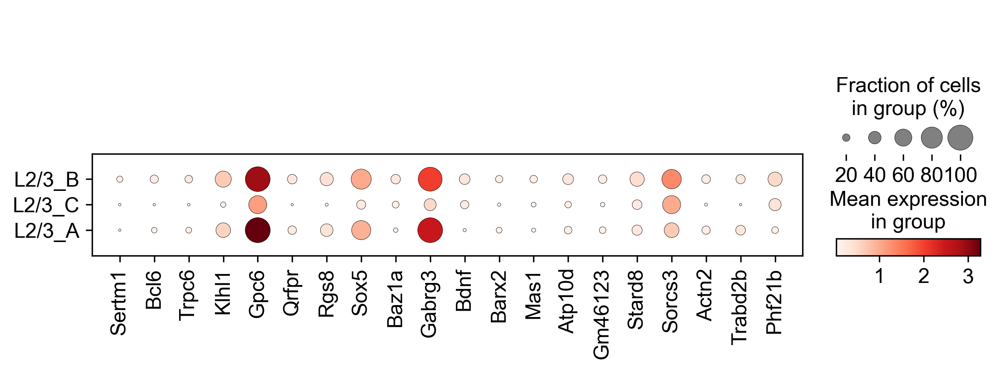

['Sertm1', 'Bcl6', 'Trpc6', 'Klhl1', 'Gpc6', 'Qrfpr']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:11)


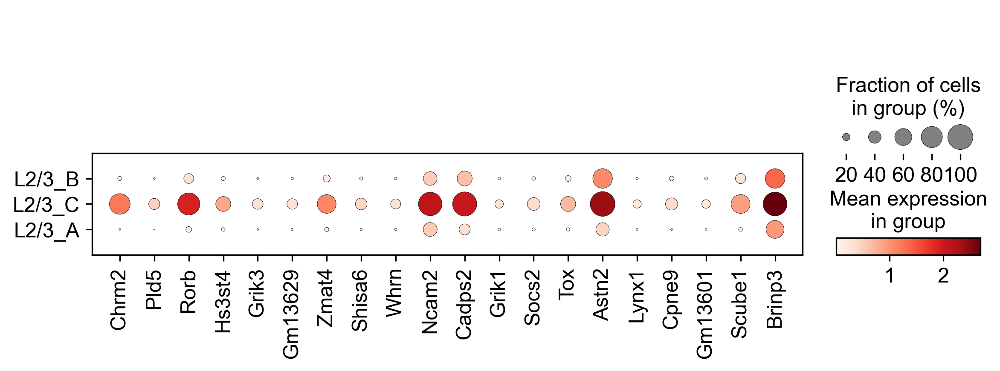

['Chrm2', 'Pld5', 'Rorb', 'Hs3st4', 'Grik3', 'Gm13629']


In [51]:
adata_23 = adata[adata.obs.Subclass=='L2/3',:]
LFs = []
for i in ['L2/3_A', 'L2/3_B', 'L2/3_C']:
    Type = i
    sc.tl.rank_genes_groups(adata_23, groupby='Type', groups=[Type], reference='rest', method='wilcoxon', n_genes=250)
    #wilcGenes23vRest = list(adata_23.uns['rank_genes_groups']['names'].astype([(Type, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    #if ('Malat1' in wilcGenes23vRest): del wilcGenes23vRest[wilcGenes23vRest.index('Malat1')]

    wilcLF8v14 = adata_23.uns['rank_genes_groups']['logfoldchanges'].astype([(Type, '<f8')]).view('<f8') #log fold changes ordered by score

    wilcGenes8v14_s = list(adata_23.uns['rank_genes_groups']['names'].astype([(Type, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    wilcLF8v14_s = adata_23.uns['rank_genes_groups']['logfoldchanges'].astype([(Type, '<f8')]).view('<f8') #numpy array of logfoldchnages to be ordered lowest to highest
    wilcLF8v14_s.sort() #log fold changes from lowest to highest
    wilcGenes8v14 = [] #list of genes ordered by logfold change: low to high
    for i in wilcLF8v14_s:
        gene_idx = np.where(wilcLF8v14 == i)[0][0]
        wilcGenes8v14.append(wilcGenes8v14_s[gene_idx])
    wilcGenes8v14_correct = []
    for i in reversed(wilcGenes8v14):
        wilcGenes8v14_correct.append(i) # #list of genes ordered by logfold change high to low

    sc.pl.dotplot(adata_23, wilcGenes8v14_correct[0:20], groupby='Type')
    print(wilcGenes8v14_correct[0:6])
    LFs.append(wilcLF8v14_s)

In [126]:
adata_23 = adata[adata.obs.leiden=='0',:].concatenate(adata[adata.obs.leiden=='4',:], 
                                                                  adata[adata.obs.leiden=='7',:])

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


## Tuning cluster resolution P17

In [58]:
def_res_leiden_234 = (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))
def_res_leiden_56 = (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [ ]:
ARI_234 = []
ARI_56 = []

NCE_234 = []
NCE_56 = []

for res in np.arange(1,2.1, 0.1):
    sc.tl.leiden(adata, resolution=res)
    fig, axs = plt.subplots(1, 3, figsize = (13.5,4), constrained_layout=True)
    sc.pl.umap(adata, color='cluster', legend_fontsize='10', ax=axs[0], 
               show=False, title='P14: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
    sc.pl.umap(adata, color='leiden', ax=axs[1], show=False, title='P14 Leiden: ' + str(res) + ' res', legend_loc='on data')
    sc.pl.umap(adata, color='sample', ax=axs[2], show=False, title='P14: ' + str(adata.shape[0]) + ' cells')
    ARI_234.append(adjusted_rand_score(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    ARI_56.append(adjusted_rand_score(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

    NCE_234.append(calculateNCE(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    NCE_56.append(calculateNCE(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

In [155]:
adata = sc.read_h5ad('P17_glut_12022020.h5ad')

In [ ]:
layer = []
for i in range(adata.shape[0]):
    if (adata.obs.Type[i][0:2]=='L2'): layer.append('L2/3')
    elif (adata.obs.Type[i][0:2]=='L4'): layer.append('L4')
    elif (adata.obs.Type[i][0:2]=='L5'): layer.append('L5')
    elif (adata.obs.Type[i][0:2]=='L6'): layer.append('L6')   

adata.obs['layer'] = adata.obs['subclass']
adata.obs['layer'] = pd.Series(layer, dtype='category').values

def_res_leiden_23 = (list(adata[adata.obs.layer=='L2/3',:].obs.leiden.values))
def_res_leiden_4 = (list(adata[adata.obs.layer=='L4',:].obs.leiden.values))

def_res_leiden_5 = (list(adata[adata.obs.layer=='L5',:].obs.leiden.values))
def_res_leiden_6 = (list(adata[adata.obs.layer=='L6',:].obs.leiden.values))

ARI_23 = []
ARI_4 = []

ARI_5 = []
ARI_6 = []

NCE_234 = []
NCE_56 = []

for res in np.arange(1,2.1, 0.1):
    sc.tl.leiden(adata, resolution=res)
    fig, axs = plt.subplots(1, 3, figsize = (13.5,4), constrained_layout=True)
    sc.pl.umap(adata, color='cluster', legend_fontsize='10', ax=axs[0], 
               show=False, title='P17: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
    sc.pl.umap(adata, color='leiden', ax=axs[1], show=False, title='P17 Leiden: ' + str(res) + ' res', legend_loc='on data')
    sc.pl.umap(adata, color='sample', ax=axs[2], show=False, title='P17: ' + str(adata.shape[0]) + ' cells')
    ARI_23.append(adjusted_rand_score(def_res_leiden_23, (list(adata[adata.obs.layer=='L2/3',:].obs.leiden.values))))
    ARI_4.append(adjusted_rand_score(def_res_leiden_4, (list(adata[adata.obs.layer=='L4',:].obs.leiden.values))))

    ARI_5.append(adjusted_rand_score(def_res_leiden_5, (list(adata[adata.obs.layer=='L5',:].obs.leiden.values))))
    ARI_6.append(adjusted_rand_score(def_res_leiden_6, (list(adata[adata.obs.layer=='L6',:].obs.leiden.values))))

    #NCE_234.append(calculateNCE(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    #NCE_56.append(calculateNCE(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

ARIs_P17 = [ARI_23, ARI_4, ARI_5, ARI_6]

P17 = pd.DataFrame(np.transpose(np.array(ARIs_P17)), columns=adata.obs.layer.values.categories)
P17['res'] = np.arange(1,2.1, 0.1)
P17

# P21

In [4]:
adata = sc.read_h5ad('P21_glut08122020.h5ad')
del adata.obsp
del adata.varm
del adata.obsm
del adata.uns
adata

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/compat/__init__.py:161: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,
/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/compat/__init__.py:161: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  FutureWarning,


AnnData object with n_obs × n_vars = 16066 × 30869
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'sample', 'Age', 'subclass'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'

In [12]:
adata.X = adata.raw.X.A
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5) #HVGs


sc.pp.scale(adata, max_value=10) #scale
sc.tl.pca(adata, svd_solver='arpack') #run PCA

Z = harmonize(adata.obsm['X_pca'], adata.obs, batch_key = 'sample')
adata.obsm['X_harmony'] = Z

sc.pp.neighbors(adata, n_neighbors=25, use_rep='X_harmony')

#sc.pp.neighbors(adata, n_neighbors=25)
#bbknn(adata, batch_key='sample',neighbors_within_batch =6 ) #doesn't work
#sc.tl.leiden(adata)
sc.tl.umap(adata)

extracting highly variable genes
    finished (0:00:05)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:05)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
Reach convergence after 4 iteration(s).
computing neighbors


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../../opt/anaconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:14)


#super small, diffuse expression, no correspondence to former clusters
adata = adata[adata.obs['leiden']!='16',:]

In [6]:
layer = []
for i in range(adata.shape[0]):
    if (adata.obs.cluster[i][0:2]=='L2'): layer.append('L2/3/4')
    elif (adata.obs.cluster[i][0:2]=='L4'): layer.append('L2/3/4')
    elif (adata.obs.cluster[i][0:2]=='L5'): layer.append('L5/6')
    elif (adata.obs.cluster[i][0:2]=='L6'): layer.append('L5/6')   

adata.obs['layer'] = adata.obs['subclass']
adata.obs['layer'] = pd.Series(layer, dtype='category').values

## Final clustering P21

In [86]:
#adata = sc.read_h5ad('P21_glut_11222020.h5ad')
adata = sc.read_h5ad('P21_glut_12012020.h5ad')

In [87]:
Type = ['L4_A',
        'L2/3_B', 'L6CT_B', 'L6IT_A', 
       'L2/3_A', 'L4_B', 'L6CT_C', 
       'L5IT', 'L2/3_C', 'L4_C', 
       'L5PT_A', 'L5NP', 'L6IT_B', 
       'L6CT_A', 'L6b', 'L5PT_B'] 

adata.obs['Type'] = adata.obs['leiden']
a = adata.obs['Type']
adata.obs['Type'] = a.cat.rename_categories(Type).values
#adata.rename_categories(key='cluster', categories=[cluster])

<AxesSubplot:title={'center':'P21: 15979 cells'}, xlabel='UMAP1', ylabel='UMAP2'>

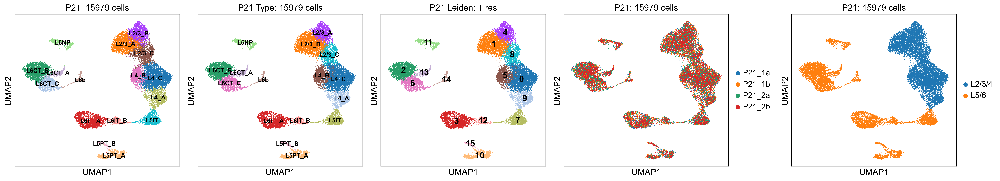

In [17]:
#sc.tl.leiden(adata)
fig, axs = plt.subplots(1, 5, figsize = (22.5,4), constrained_layout=True)
sc.pl.umap(adata, color='cluster', legend_fontsize='10', ax=axs[0], 
           show=False, title='P21: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
sc.pl.umap(adata, color='Type', legend_fontsize='10', ax=axs[1], 
           show=False, title='P21 Type: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
sc.pl.umap(adata, color='leiden', ax=axs[2], show=False, title='P21 Leiden: ' + str(adata.uns['leiden']['params']['resolution']) + ' res', legend_loc='on data')
sc.pl.umap(adata, color='sample', ax=axs[3], show=False, title='P21: ' + str(adata.shape[0]) + ' cells')
sc.pl.umap(adata, color='layer', ax=axs[4], show=False, title='P21: ' + str(adata.shape[0]) + ' cells')

In [14]:
sc.tl.dendrogram(adata, groupby='leiden', use_rep='X_harmony')

Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


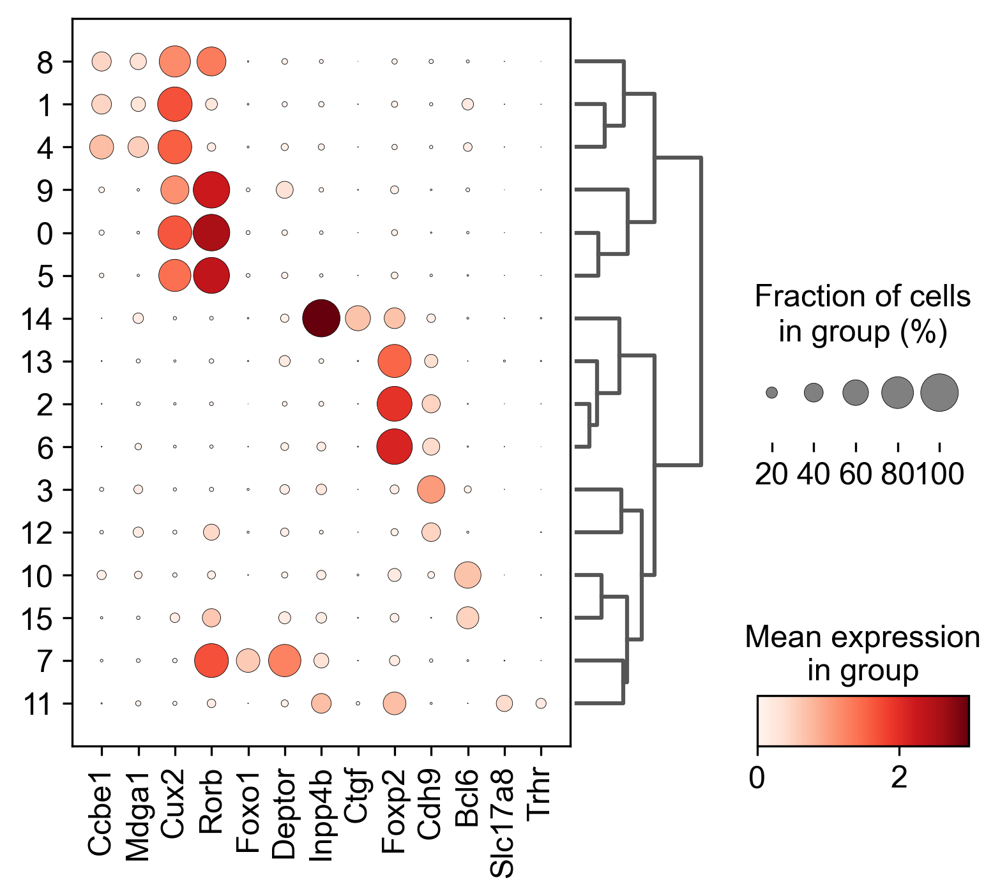

In [16]:
bias_markers = ['Ccbe1',  'Mdga1', 'Cux2', 'Rorb', 'Foxo1', 'Deptor', 'Inpp4b', 'Ctgf', 'Foxp2', 'Cdh9', 'Bcl6', 'Slc17a8', 'Trhr', ]
sc.pl.dotplot(adata, bias_markers, 
              groupby='leiden', dendrogram=True, figsize=(6,5))

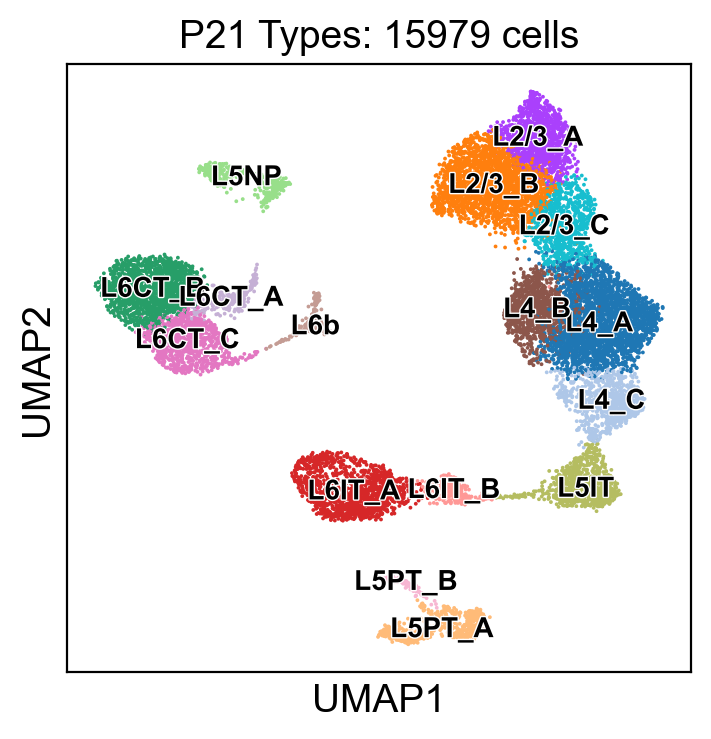

In [88]:
sc.pl.umap(adata, color='Type', legend_fontsize='10',
           title='P21 Types: ' + str(adata.shape[0]) + ' cells', legend_loc='on data', 
           legend_fontoutline=1)

In [44]:
adata.obs['Subclass'] = adata.obs['Type']
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_1','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_2','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_3','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_A','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_B','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_C','')

In [90]:
adata.write_h5ad('P21_glut_12012020.h5ad')

## L2/3 at P21

ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
Trying to set attribute `.uns` of view, copying.


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


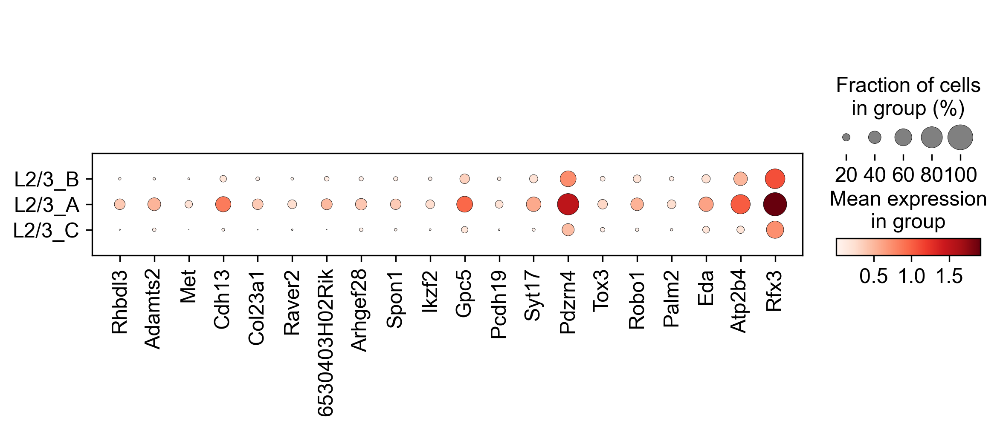

['Rhbdl3', 'Adamts2', 'Met', 'Cdh13', 'Col23a1', 'Raver2']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


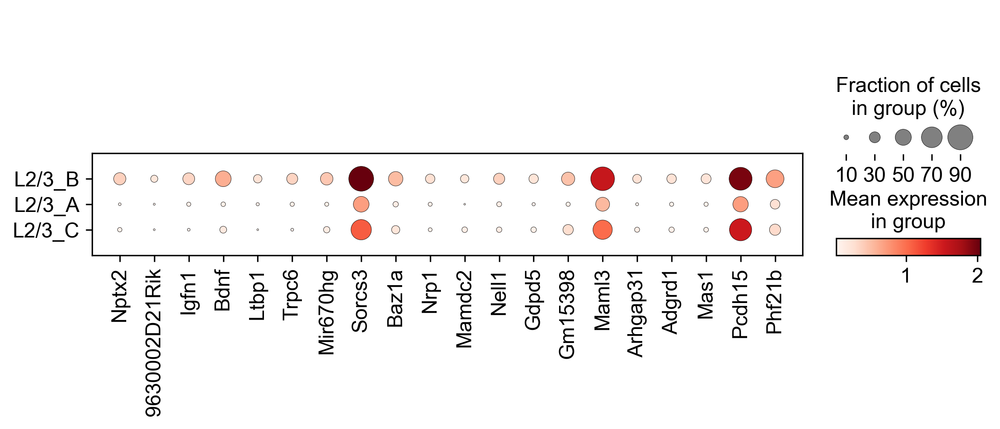

['Nptx2', '9630002D21Rik', 'Igfn1', 'Bdnf', 'Ltbp1', 'Trpc6']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:08)


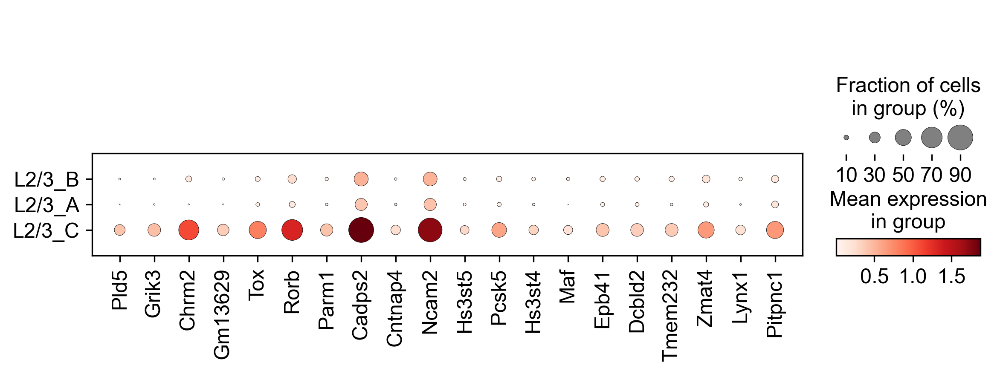

['Pld5', 'Grik3', 'Chrm2', 'Gm13629', 'Tox', 'Rorb']


In [54]:
adata_23 = adata[adata.obs.Subclass=='L2/3',:]
LFs = []
for i in ['L2/3_A', 'L2/3_B', 'L2/3_C']:
    Type = i
    sc.tl.rank_genes_groups(adata_23, groupby='Type', groups=[Type], reference='rest', method='wilcoxon', n_genes=250)
    #wilcGenes23vRest = list(adata_23.uns['rank_genes_groups']['names'].astype([(Type, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    #if ('Malat1' in wilcGenes23vRest): del wilcGenes23vRest[wilcGenes23vRest.index('Malat1')]

    wilcLF8v14 = adata_23.uns['rank_genes_groups']['logfoldchanges'].astype([(Type, '<f8')]).view('<f8') #log fold changes ordered by score

    wilcGenes8v14_s = list(adata_23.uns['rank_genes_groups']['names'].astype([(Type, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    wilcLF8v14_s = adata_23.uns['rank_genes_groups']['logfoldchanges'].astype([(Type, '<f8')]).view('<f8') #numpy array of logfoldchnages to be ordered lowest to highest
    wilcLF8v14_s.sort() #log fold changes from lowest to highest
    wilcGenes8v14 = [] #list of genes ordered by logfold change: low to high
    for i in wilcLF8v14_s:
        gene_idx = np.where(wilcLF8v14 == i)[0][0]
        wilcGenes8v14.append(wilcGenes8v14_s[gene_idx])
    wilcGenes8v14_correct = []
    for i in reversed(wilcGenes8v14):
        wilcGenes8v14_correct.append(i) # #list of genes ordered by logfold change high to low

    sc.pl.dotplot(adata_23, wilcGenes8v14_correct[0:20], groupby='Type')
    print(wilcGenes8v14_correct[0:6])
    LFs.append(wilcLF8v14_s)

## Tuning cluster resolution P21

In [18]:
def_res_leiden_234 = (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))
def_res_leiden_56 = (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [ ]:
ARI_234 = []
ARI_56 = []

NCE_234 = []
NCE_56 = []

for res in np.arange(1,2.1, 0.1):
    sc.tl.leiden(adata, resolution=res)
    fig, axs = plt.subplots(1, 3, figsize = (13.5,4), constrained_layout=True)
    sc.pl.umap(adata, color='cluster', legend_fontsize='10', ax=axs[0], 
               show=False, title='P21: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
    sc.pl.umap(adata, color='leiden', ax=axs[1], show=False, title='P21 Leiden: ' + str(res) + ' res', legend_loc='on data')
    sc.pl.umap(adata, color='sample', ax=axs[2], show=False, title='P21: ' + str(adata.shape[0]) + ' cells')
    ARI_234.append(adjusted_rand_score(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    ARI_56.append(adjusted_rand_score(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

    NCE_234.append(calculateNCE(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    NCE_56.append(calculateNCE(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

In [ ]:
adata = sc.read_h5ad('P21_glut_12012020.h5ad')

layer = []
for i in range(adata.shape[0]):
    if (adata.obs.Type[i][0:2]=='L2'): layer.append('L2/3')
    elif (adata.obs.Type[i][0:2]=='L4'): layer.append('L4')
    elif (adata.obs.Type[i][0:2]=='L5'): layer.append('L5')
    elif (adata.obs.Type[i][0:2]=='L6'): layer.append('L6')   

adata.obs['layer'] = adata.obs['subclass']
adata.obs['layer'] = pd.Series(layer, dtype='category').values

def_res_leiden_23 = (list(adata[adata.obs.layer=='L2/3',:].obs.leiden.values))
def_res_leiden_4 = (list(adata[adata.obs.layer=='L4',:].obs.leiden.values))

def_res_leiden_5 = (list(adata[adata.obs.layer=='L5',:].obs.leiden.values))
def_res_leiden_6 = (list(adata[adata.obs.layer=='L6',:].obs.leiden.values))

ARI_23 = []
ARI_4 = []

ARI_5 = []
ARI_6 = []

NCE_234 = []
NCE_56 = []

for res in np.arange(1,2.1, 0.1):
    sc.tl.leiden(adata, resolution=res)
    fig, axs = plt.subplots(1, 3, figsize = (13.5,4), constrained_layout=True)
    sc.pl.umap(adata, color='cluster', legend_fontsize='10', ax=axs[0], 
               show=False, title='P21: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
    sc.pl.umap(adata, color='leiden', ax=axs[1], show=False, title='P21 Leiden: ' + str(res) + ' res', legend_loc='on data')
    sc.pl.umap(adata, color='sample', ax=axs[2], show=False, title='P21: ' + str(adata.shape[0]) + ' cells')
    ARI_23.append(adjusted_rand_score(def_res_leiden_23, (list(adata[adata.obs.layer=='L2/3',:].obs.leiden.values))))
    ARI_4.append(adjusted_rand_score(def_res_leiden_4, (list(adata[adata.obs.layer=='L4',:].obs.leiden.values))))

    ARI_5.append(adjusted_rand_score(def_res_leiden_5, (list(adata[adata.obs.layer=='L5',:].obs.leiden.values))))
    ARI_6.append(adjusted_rand_score(def_res_leiden_6, (list(adata[adata.obs.layer=='L6',:].obs.leiden.values))))

    #NCE_234.append(calculateNCE(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    #NCE_56.append(calculateNCE(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

ARIs_P21 = [ARI_23, ARI_4, ARI_5, ARI_6]

P21 = pd.DataFrame(np.transpose(np.array(ARIs_P21)), columns=adata.obs.layer.values.categories)
P21['res'] = np.arange(1,2.1, 0.1)
P21

# P28

In [22]:
adata = sc.read_h5ad('P28_glut08312020.h5ad')
del adata.obsp
del adata.varm
del adata.obsm
del adata.uns
adata

AnnData object with n_obs × n_vars = 15378 × 30869
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'sample', 'Age', 'subclass', 'sample_new'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'

In [29]:
adata.X = adata.raw.X.A
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5) #HVGs


sc.pp.scale(adata, max_value=10) #scale
sc.tl.pca(adata, svd_solver='arpack') #run PCA

Z = harmonize(adata.obsm['X_pca'], adata.obs, batch_key = 'sample')
adata.obsm['X_harmony'] = Z

sc.pp.neighbors(adata, n_neighbors=25, use_rep='X_harmony')

#sc.pp.neighbors(adata, n_neighbors=25)
#bbknn(adata, batch_key='sample',neighbors_within_batch =6 ) #doesn't work
#sc.tl.leiden(adata)
sc.tl.umap(adata)

extracting highly variable genes
    finished (0:00:05)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
Reach convergence after 3 iteration(s).
computing neighbors


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../../opt/anaconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:13)


#super small, diffuse expression, no correspondence to former clusters
adata = adata[adata.obs['leiden']!='17',:]

In [26]:
layer = []
for i in range(adata.shape[0]):
    if (adata.obs.cluster[i][0:2]=='L2'): layer.append('L2/3/4')
    elif (adata.obs.cluster[i][0:2]=='L4'): layer.append('L2/3/4')
    elif (adata.obs.cluster[i][0:2]=='L5'): layer.append('L5/6')
    elif (adata.obs.cluster[i][0:2]=='L6'): layer.append('L5/6')   

adata.obs['layer'] = adata.obs['subclass']
adata.obs['layer'] = pd.Series(layer, dtype='category').values

## Final clustering P28

In [3]:
#adata = sc.read_h5ad('P28_glut_11222020.h5ad')
adata = sc.read_h5ad('P28_glut_12012020.h5ad')

In [4]:
sc.tl.leiden(adata, resolution=1.1)

running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:06)


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


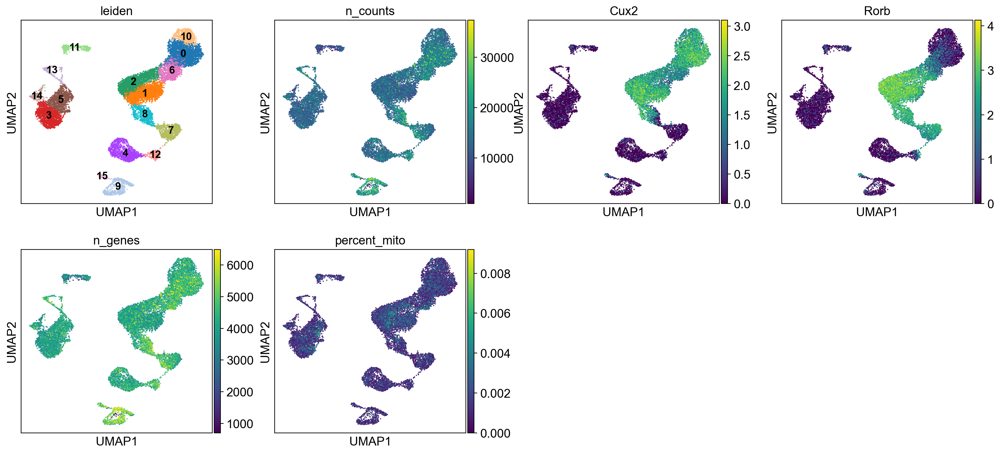

In [5]:
sc.pl.umap(adata, color=['leiden', 'n_counts', 'Cux2', 'Rorb', 
                            'n_genes', 'percent_mito'], legend_loc='on data', legend_fontsize='12',)

In [6]:
Type = ['L2/3_B', 
       'L4_B', 'L4_A',
        'L6CT_B', 'L6IT_A', 
         'L6CT_C', 'L2/3_C',
       'L5IT',  'L4_C', 'L5PT_A',
        'L2/3_A', 'L5NP', 'L6IT_B', 'L6b',
       'L6CT_A',  'L5PT_B'] 

adata.obs['Type'] = adata.obs['leiden']
a = adata.obs['Type']
adata.obs['Type'] = a.cat.rename_categories(Type).values
#adata.rename_categories(key='cluster', categories=[cluster])

<AxesSubplot:title={'center':'P28: 15315 cells'}, xlabel='UMAP1', ylabel='UMAP2'>

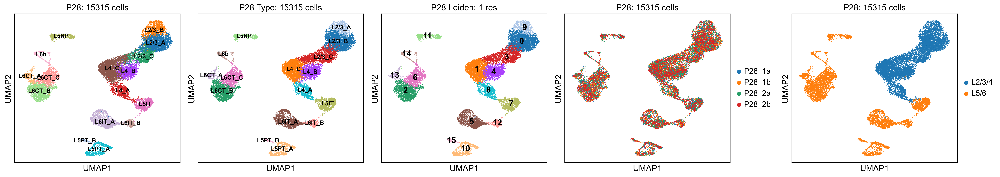

In [8]:
#sc.tl.leiden(adata)
fig, axs = plt.subplots(1, 5, figsize = (23,4), constrained_layout=True)
sc.pl.umap(adata, color='cluster', legend_fontsize='10', ax=axs[0], 
           show=False, title='P28: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
sc.pl.umap(adata, color='Type', legend_fontsize='10', ax=axs[1], 
           show=False, title='P28 Type: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
sc.pl.umap(adata, color='leiden', ax=axs[2], show=False, title='P28 Leiden: ' + str(adata.uns['leiden']['params']['resolution']) + ' res', legend_loc='on data')
sc.pl.umap(adata, color='sample', ax=axs[3], show=False, title='P28: ' + str(adata.shape[0]) + ' cells')
sc.pl.umap(adata, color='layer', ax=axs[4], show=False, title='P28: ' + str(adata.shape[0]) + ' cells')

In [31]:
sc.tl.dendrogram(adata, groupby='leiden', use_rep='X_harmony')

Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


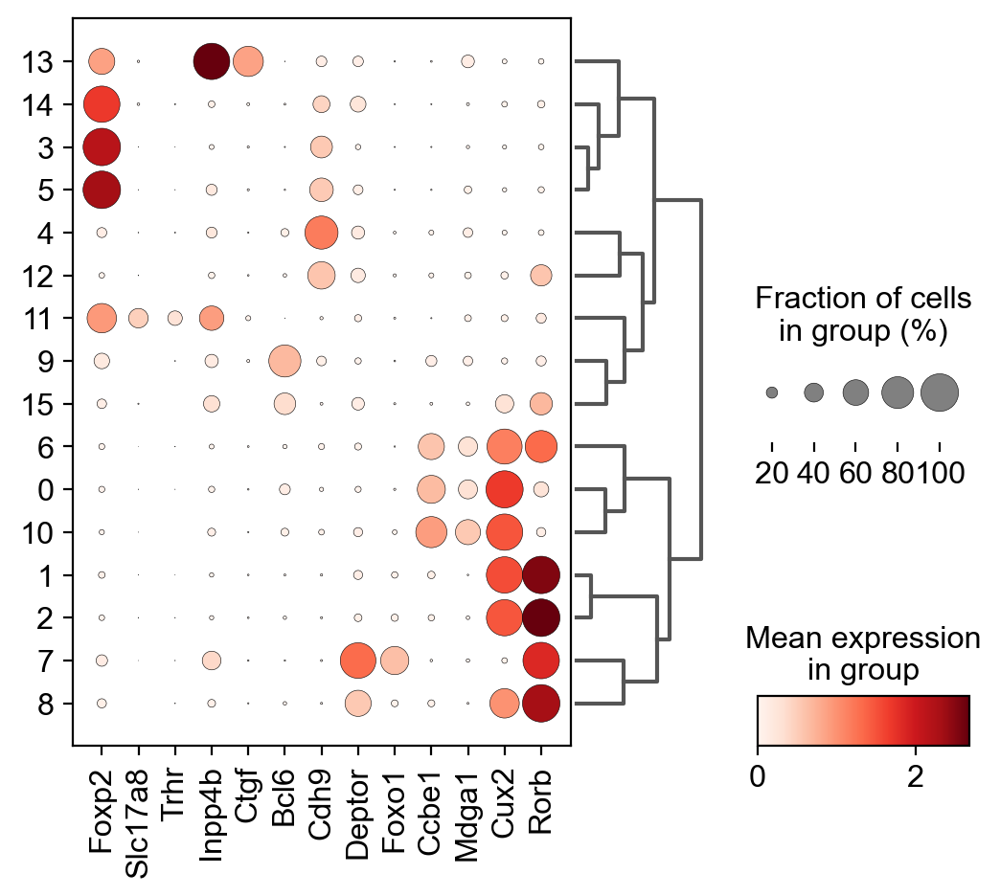

In [8]:
bias_markers = ['Foxp2',  'Slc17a8', 'Trhr', 'Inpp4b', 'Ctgf', 'Bcl6', 'Cdh9',  'Deptor', 'Foxo1', 'Ccbe1',  
                'Mdga1', 'Cux2', 'Rorb']
sc.tl.dendrogram(adata, groupby='leiden')
sc.pl.dotplot(adata, bias_markers, 
              groupby='leiden', dendrogram=True, figsize=(6,5))

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


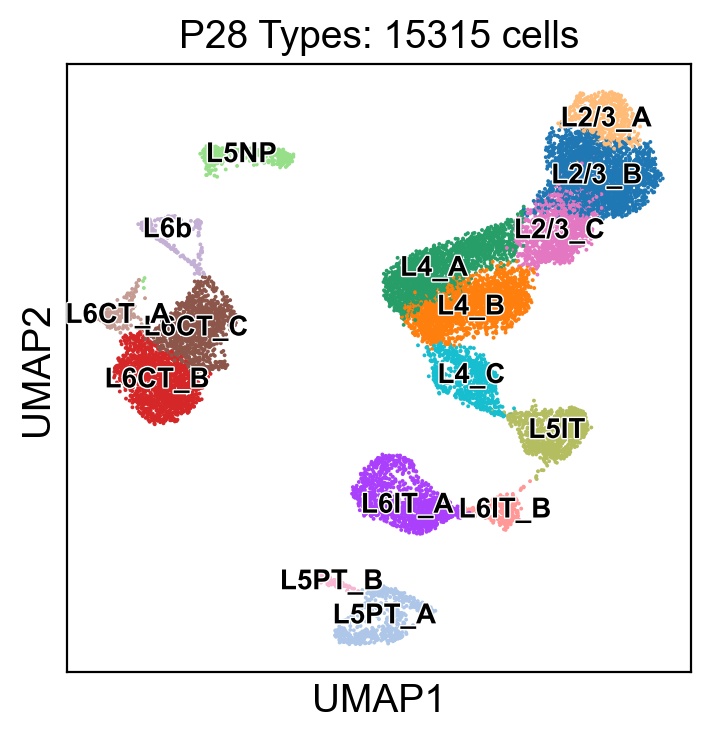

In [9]:
sc.pl.umap(adata, color='Type', legend_fontsize='10',
           title='P28 Types: ' + str(adata.shape[0]) + ' cells', legend_loc='on data', 
           legend_fontoutline=1)



In [4]:
adata = sc.read_h5ad('P28_glut_03222021.h5ad')

In [5]:
adata.obs['Subclass'] = adata.obs['Type']
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_1','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_2','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_3','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_A','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_B','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_C','')

In [6]:
#adata.write_h5ad('P28_glut_11222020.h5ad')
#adata.write_h5ad('P28_glut_12012020.h5ad')
adata.write_h5ad('P28_glut_03222021.h5ad')

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'Subclass' as categorical


## L2/3 at P28

In [58]:
adata_23 = adata[adata.obs.Type=='L2/3_A',:].concatenate(adata[adata.obs.Type=='L2/3_B',:], 
                                                                  adata[adata.obs.Type=='L2/3_C',:])

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:08)


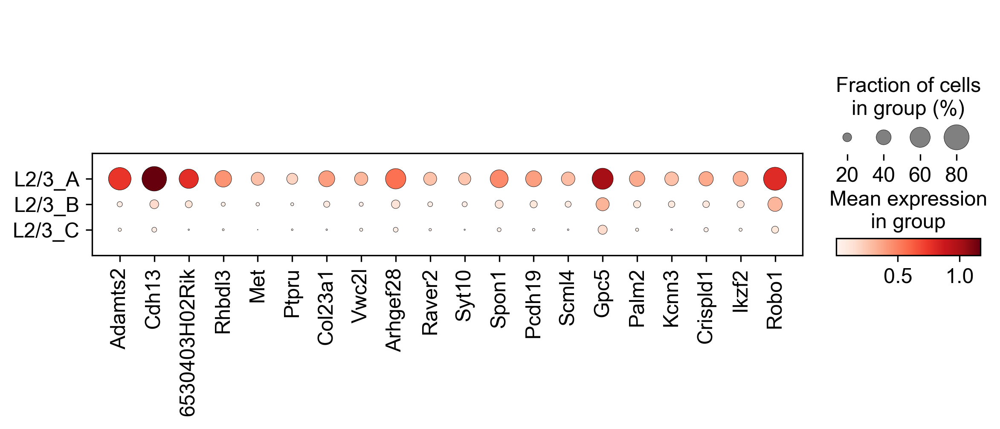

['Adamts2', 'Cdh13', '6530403H02Rik', 'Rhbdl3', 'Met', 'Ptpru']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:08)


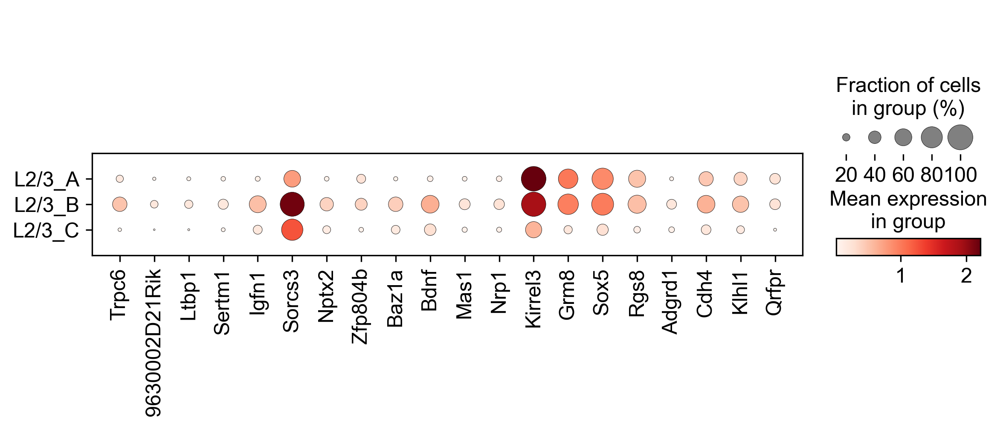

['Trpc6', '9630002D21Rik', 'Ltbp1', 'Sertm1', 'Igfn1', 'Sorcs3']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:08)


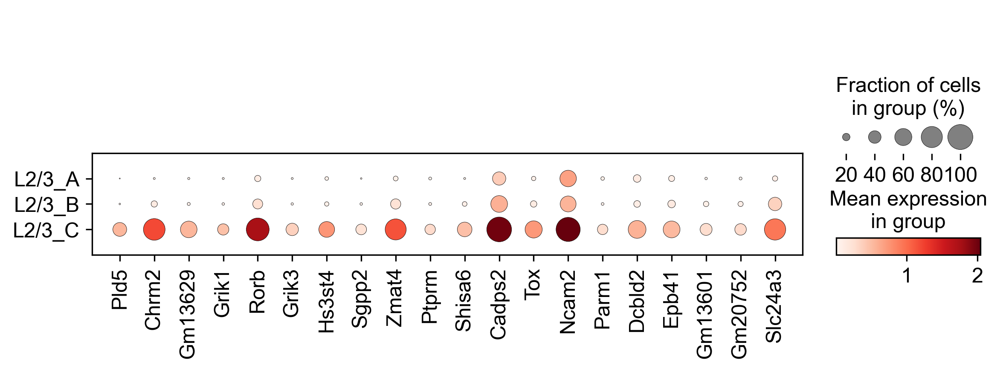

['Pld5', 'Chrm2', 'Gm13629', 'Grik1', 'Rorb', 'Grik3']


In [62]:
LFs = []
for i in ['L2/3_A', 'L2/3_B', 'L2/3_C']:
    Type = i
    sc.tl.rank_genes_groups(adata_23, groupby='Type', groups=[Type], reference='rest', method='wilcoxon', n_genes=250)
    #wilcGenes23vRest = list(adata_23.uns['rank_genes_groups']['names'].astype([(Type, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    #if ('Malat1' in wilcGenes23vRest): del wilcGenes23vRest[wilcGenes23vRest.index('Malat1')]

    wilcLF8v14 = adata_23.uns['rank_genes_groups']['logfoldchanges'].astype([(Type, '<f8')]).view('<f8') #log fold changes ordered by score

    wilcGenes8v14_s = list(adata_23.uns['rank_genes_groups']['names'].astype([(Type, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    wilcLF8v14_s = adata_23.uns['rank_genes_groups']['logfoldchanges'].astype([(Type, '<f8')]).view('<f8') #numpy array of logfoldchnages to be ordered lowest to highest
    wilcLF8v14_s.sort() #log fold changes from lowest to highest
    wilcGenes8v14 = [] #list of genes ordered by logfold change: low to high
    for i in wilcLF8v14_s:
        gene_idx = np.where(wilcLF8v14 == i)[0][0]
        wilcGenes8v14.append(wilcGenes8v14_s[gene_idx])
    wilcGenes8v14_correct = []
    for i in reversed(wilcGenes8v14):
        wilcGenes8v14_correct.append(i) # #list of genes ordered by logfold change high to low

    sc.pl.dotplot(adata_23, wilcGenes8v14_correct[0:20], groupby='Type')
    print(wilcGenes8v14_correct[0:6])
    LFs.append(wilcLF8v14_s)

## Tuning cluster resolution P28

In [34]:
def_res_leiden_234 = (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))
def_res_leiden_56 = (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [ ]:
ARI_234 = []
ARI_56 = []

NCE_234 = []
NCE_56 = []

for res in np.arange(1,2.1, 0.1):
    sc.tl.leiden(adata, resolution=res)
    fig, axs = plt.subplots(1, 3, figsize = (13.5,4), constrained_layout=True)
    sc.pl.umap(adata, color='cluster', legend_fontsize='10', ax=axs[0], 
               show=False, title='P28: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
    sc.pl.umap(adata, color='leiden', ax=axs[1], show=False, title='P28 Leiden: ' + str(res) + ' res', legend_loc='on data')
    sc.pl.umap(adata, color='sample', ax=axs[2], show=False, title='P28: ' + str(adata.shape[0]) + ' cells')
    ARI_234.append(adjusted_rand_score(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    ARI_56.append(adjusted_rand_score(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

    NCE_234.append(calculateNCE(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    NCE_56.append(calculateNCE(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

In [248]:
adata = sc.read_h5ad('P28_glut_03222021.h5ad')

In [ ]:
layer = []
for i in range(adata.shape[0]):
    if (adata.obs.Type[i][0:2]=='L2'): layer.append('L2/3')
    elif (adata.obs.Type[i][0:2]=='L4'): layer.append('L4')
    elif (adata.obs.Type[i][0:2]=='L5'): layer.append('L5')
    elif (adata.obs.Type[i][0:2]=='L6'): layer.append('L6')   

adata.obs['layer'] = adata.obs['subclass']
adata.obs['layer'] = pd.Series(layer, dtype='category').values

def_res_leiden_23 = (list(adata[adata.obs.layer=='L2/3',:].obs.leiden.values))
def_res_leiden_4 = (list(adata[adata.obs.layer=='L4',:].obs.leiden.values))

def_res_leiden_5 = (list(adata[adata.obs.layer=='L5',:].obs.leiden.values))
def_res_leiden_6 = (list(adata[adata.obs.layer=='L6',:].obs.leiden.values))

ARI_23 = []
ARI_4 = []

ARI_5 = []
ARI_6 = []

NCE_234 = []
NCE_56 = []

for res in np.arange(1,2.1, 0.1):
    sc.tl.leiden(adata, resolution=res)
    fig, axs = plt.subplots(1, 3, figsize = (13.5,4), constrained_layout=True)
    sc.pl.umap(adata, color='cluster', legend_fontsize='10', ax=axs[0], 
               show=False, title='P28: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
    sc.pl.umap(adata, color='leiden', ax=axs[1], show=False, title='P28 Leiden: ' + str(res) + ' res', legend_loc='on data')
    sc.pl.umap(adata, color='sample', ax=axs[2], show=False, title='P28: ' + str(adata.shape[0]) + ' cells')
    ARI_23.append(adjusted_rand_score(def_res_leiden_23, (list(adata[adata.obs.layer=='L2/3',:].obs.leiden.values))))
    ARI_4.append(adjusted_rand_score(def_res_leiden_4, (list(adata[adata.obs.layer=='L4',:].obs.leiden.values))))

    ARI_5.append(adjusted_rand_score(def_res_leiden_5, (list(adata[adata.obs.layer=='L5',:].obs.leiden.values))))
    ARI_6.append(adjusted_rand_score(def_res_leiden_6, (list(adata[adata.obs.layer=='L6',:].obs.leiden.values))))

    #NCE_234.append(calculateNCE(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    #NCE_56.append(calculateNCE(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

ARIs_P28 = [ARI_23, ARI_4, ARI_5, ARI_6]

P28 = pd.DataFrame(np.transpose(np.array(ARIs_P28)), columns=adata.obs.layer.values.categories)
P28['res'] = np.arange(1,2.1, 0.1)
P28

In [252]:
P28

,L2/3,L4,L5,L6,res
0,0.919936,0.433685,1.000000,0.935015,1.0
1,1.000000,1.000000,1.000000,1.000000,1.1
2,0.579527,0.443622,1.000000,0.938439,1.2
3,0.751247,0.408972,0.997522,0.959373,1.3
4,0.855619,0.419616,0.999533,0.964530,1.4
5,0.522386,0.429721,0.994981,0.894770,1.5
6,0.403780,0.569702,0.949310,0.899924,1.6
7,0.486478,0.506577,0.950283,0.819417,1.7
8,0.517427,0.581128,0.836064,0.880111,1.8
9,0.376469,0.497311,0.831609,0.649058,1.9


In [263]:
P28[1:2]

,L2/3,L4,L5,L6,res
1,1.0,1.0,1.0,1.0,1.1


In [265]:
P28 = pd.concat([P28[1:2], P28[0:1], P28[2:]])

In [266]:
P28['res'] = np.arange(1,2.1, 0.1)

In [267]:
P28

,L2/3,L4,L5,L6,res
1,1.000000,1.000000,1.000000,1.000000,1.0
0,0.919936,0.433685,1.000000,0.935015,1.1
2,0.579527,0.443622,1.000000,0.938439,1.2
3,0.751247,0.408972,0.997522,0.959373,1.3
4,0.855619,0.419616,0.999533,0.964530,1.4
5,0.522386,0.429721,0.994981,0.894770,1.5
6,0.403780,0.569702,0.949310,0.899924,1.6
7,0.486478,0.506577,0.950283,0.819417,1.7
8,0.517427,0.581128,0.836064,0.880111,1.8
9,0.376469,0.497311,0.831609,0.649058,1.9


# P38

In [37]:
adata = sc.read_h5ad('P38_glut08122020.h5ad')
del adata.obsp
del adata.varm
del adata.obsm
del adata.uns
adata

AnnData object with n_obs × n_vars = 10682 × 30869
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'sample', 'Age', 'subclass'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'

In [67]:
adata.X = adata.raw.X.A
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5) #HVGs


sc.pp.scale(adata, max_value=10) #scale
sc.tl.pca(adata, svd_solver='arpack') #run PCA

Z = harmonize(adata.obsm['X_pca'], adata.obs, batch_key = 'sample')
adata.obsm['X_harmony'] = Z

sc.pp.neighbors(adata, n_neighbors=25, use_rep='X_harmony')

#sc.pp.neighbors(adata, n_neighbors=25)
#bbknn(adata, batch_key='sample',neighbors_within_batch =6 ) #doesn't work
#sc.tl.leiden(adata)
sc.tl.umap(adata)

extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:04)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
Reach convergence after 3 iteration(s).
computing neighbors


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../../opt/anaconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:05)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)


In [69]:
layer = []
for i in range(adata.shape[0]):
    if (adata.obs.cluster[i][0:2]=='L2'): layer.append('L2/3/4')
    elif (adata.obs.cluster[i][0:2]=='L4'): layer.append('L2/3/4')
    elif (adata.obs.cluster[i][0:2]=='L5'): layer.append('L5/6')
    elif (adata.obs.cluster[i][0:2]=='L6'): layer.append('L5/6')   

adata.obs['layer'] = adata.obs['batch']
adata.obs['layer'] = pd.Series(layer, dtype='category').values

ValueError: Length of values (10485) does not match length of index (11308)

#driven by one batch, identified by raising res to 2
adata = adata[adata.obs['leiden']!='22',:]
adata = adata[adata.obs['leiden']!='23',:]

In [73]:
adata = sc.read_h5ad('P38_glut_11222020.h5ad')

## Final clustering P38

In [96]:
#adata = sc.read_h5ad('P38_glut_11222020.h5ad')
adata = sc.read_h5ad('P38_glut_12012020.h5ad')

In [97]:
Type = ['L2/3_B', 
       'L4_A', 'L6CT_B', 'L4_B', 
       'L6IT_A', 'L5IT', 'L4_C', 
       'L6CT_C', 'L5PT_A', 'L2/3_A', 
       'L2/3_C', 'L5NP', 'L6IT_B', 
       'L6CT_A', 'L6b', 'L5PT_B'] 

adata.obs['Type'] = adata.obs['leiden']
a = adata.obs['Type']
adata.obs['Type'] = a.cat.rename_categories(Type).values
#adata.rename_categories(key='cluster', categories=[cluster])

<AxesSubplot:title={'center':'P38: 10485 cells'}, xlabel='UMAP1', ylabel='UMAP2'>

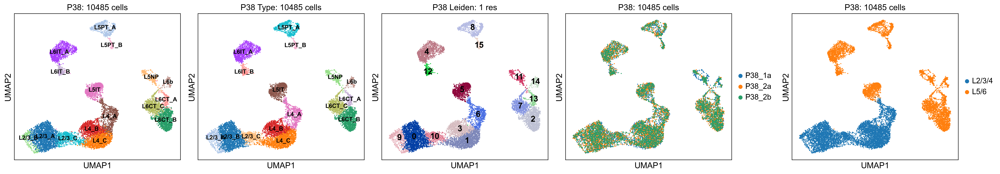

In [12]:
#sc.tl.leiden(adata)
fig, axs = plt.subplots(1, 5, figsize = (23.5,4), constrained_layout=True)
sc.pl.umap(adata, color='cluster', legend_fontsize='10', ax=axs[0], 
           show=False, title='P38: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
sc.pl.umap(adata, color='Type', legend_fontsize='10', ax=axs[1], 
           show=False, title='P38 Type: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
sc.pl.umap(adata, color='leiden', ax=axs[2], show=False, title='P38 Leiden: ' + str(adata.uns['leiden']['params']['resolution']) + ' res', legend_loc='on data')
sc.pl.umap(adata, color='sample', ax=axs[3], show=False, title='P38: ' + str(adata.shape[0]) + ' cells')
sc.pl.umap(adata, color='layer', ax=axs[4], show=False, title='P38: ' + str(adata.shape[0]) + ' cells')

In [46]:
sc.tl.dendrogram(adata, groupby='leiden', use_rep='X_harmony')

Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


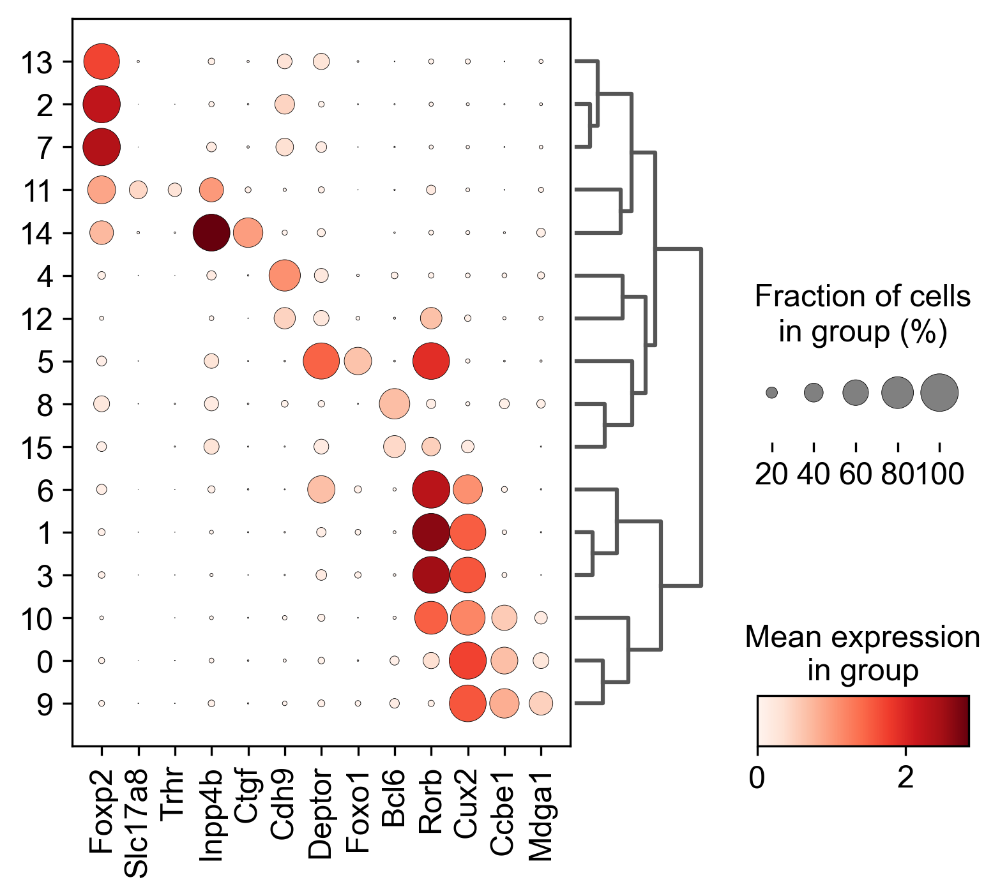

In [90]:
bias_markers = ['Foxp2',  'Slc17a8', 'Trhr', 'Inpp4b', 'Ctgf',  'Cdh9',  'Deptor', 
                'Foxo1', 'Bcl6', 'Rorb', 'Cux2', 'Ccbe1',  
                'Mdga1']
sc.pl.dotplot(adata, bias_markers, 
              groupby='leiden', dendrogram=True, figsize=(6,5))

In [48]:
#adata.write_h5ad('P38_glut_11222020.h5ad')

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


In [24]:
adata = sc.read_h5ad('P38_glut_12012020.h5ad')

In [28]:
Type = ['L2/3_C2', 
       'L4_C1', 'L6_C4', 'L4_C2', 
       'L6_C2', 'L5_C1', 'L4_C3', 
       'L6_C5', 'L5_C4', 'L2/3_C1', 
       'L2/3_C3', 'L5_C2', 'L6_C1', 
       'L6_C3', 'L6_C6', 'L5_C3'] 

adata.obs['Type_ccb'] = adata.obs['leiden']
a = adata.obs['Type_ccb']
adata.obs['Type_ccb'] = a.cat.rename_categories(Type).values
#adata.rename_categories(key='cluster', categories=[cluster])

In [53]:
adata.obs['Subclass'] = adata.obs['Type']
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_1','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_2','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_3','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_A','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_B','')
adata.obs['Subclass'] = adata.obs['Subclass'].str.replace('_C','')

In [100]:
adata.write_h5ad('P38_glut_12012020.h5ad')

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


## L2/3 at P38

In [65]:
adata_23 = adata[adata.obs.leiden=='0',:].concatenate(adata[adata.obs.leiden=='9',:], 
                                                                  adata[adata.obs.leiden=='10',:])

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'leiden' as categorical
... storing 'cluster' as categorical
... storing 'subclass' as categorical
... storing 'layer' as categorical
... storing 'Type' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


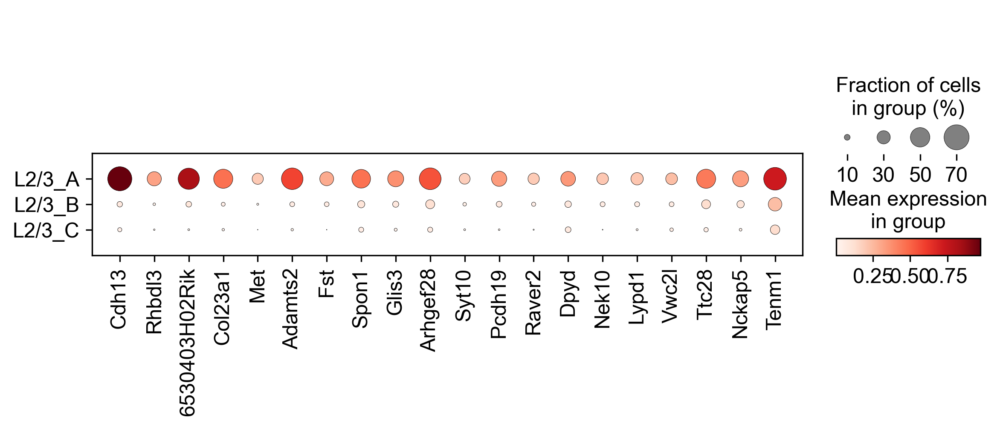

['Cdh13', 'Rhbdl3', '6530403H02Rik', 'Col23a1', 'Met', 'Adamts2']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


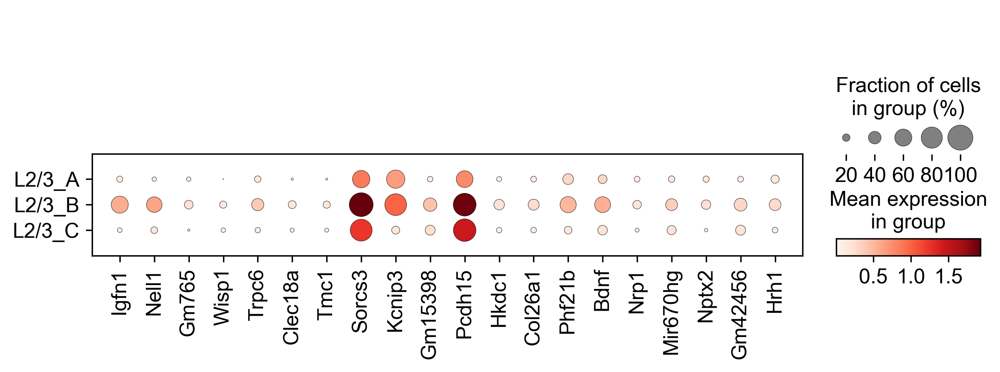

['Igfn1', 'Nell1', 'Gm765', 'Wisp1', 'Trpc6', 'Clec18a']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


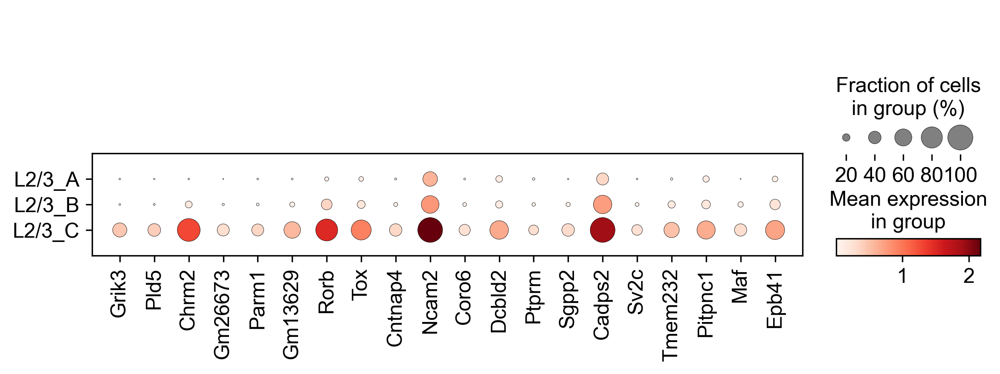

['Grik3', 'Pld5', 'Chrm2', 'Gm26673', 'Parm1', 'Gm13629']


In [66]:
LFs = []
for i in ['L2/3_A', 'L2/3_B', 'L2/3_C']:
    Type = i
    sc.tl.rank_genes_groups(adata_23, groupby='Type', groups=[Type], reference='rest', method='wilcoxon', n_genes=250)
    #wilcGenes23vRest = list(adata_23.uns['rank_genes_groups']['names'].astype([(Type, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    #if ('Malat1' in wilcGenes23vRest): del wilcGenes23vRest[wilcGenes23vRest.index('Malat1')]

    wilcLF8v14 = adata_23.uns['rank_genes_groups']['logfoldchanges'].astype([(Type, '<f8')]).view('<f8') #log fold changes ordered by score

    wilcGenes8v14_s = list(adata_23.uns['rank_genes_groups']['names'].astype([(Type, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    wilcLF8v14_s = adata_23.uns['rank_genes_groups']['logfoldchanges'].astype([(Type, '<f8')]).view('<f8') #numpy array of logfoldchnages to be ordered lowest to highest
    wilcLF8v14_s.sort() #log fold changes from lowest to highest
    wilcGenes8v14 = [] #list of genes ordered by logfold change: low to high
    for i in wilcLF8v14_s:
        gene_idx = np.where(wilcLF8v14 == i)[0][0]
        wilcGenes8v14.append(wilcGenes8v14_s[gene_idx])
    wilcGenes8v14_correct = []
    for i in reversed(wilcGenes8v14):
        wilcGenes8v14_correct.append(i) # #list of genes ordered by logfold change high to low

    sc.pl.dotplot(adata_23, wilcGenes8v14_correct[0:20], groupby='Type')
    print(wilcGenes8v14_correct[0:6])
    LFs.append(wilcLF8v14_s)

## Tuning cluster resolution P38

In [49]:
def_res_leiden_234 = (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))
def_res_leiden_56 = (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [ ]:
ARI_234 = []
ARI_56 = []

NCE_234 = []
NCE_56 = []

for res in np.arange(1,2.1, 0.1):
    sc.tl.leiden(adata, resolution=res)
    fig, axs = plt.subplots(1, 3, figsize = (13.5,4), constrained_layout=True)
    sc.pl.umap(adata, color='cluster', legend_fontsize='10', ax=axs[0], 
               show=False, title='P28: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
    sc.pl.umap(adata, color='leiden', ax=axs[1], show=False, title='P28 Leiden: ' + str(res) + ' res', legend_loc='on data')
    sc.pl.umap(adata, color='sample', ax=axs[2], show=False, title='P28: ' + str(adata.shape[0]) + ' cells')
    ARI_234.append(adjusted_rand_score(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    ARI_56.append(adjusted_rand_score(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

    NCE_234.append(calculateNCE(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    NCE_56.append(calculateNCE(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

In [ ]:
adata = sc.read_h5ad('P38_glut_12012020.h5ad')

layer = []
for i in range(adata.shape[0]):
    if (adata.obs.Type[i][0:2]=='L2'): layer.append('L2/3')
    elif (adata.obs.Type[i][0:2]=='L4'): layer.append('L4')
    elif (adata.obs.Type[i][0:2]=='L5'): layer.append('L5')
    elif (adata.obs.Type[i][0:2]=='L6'): layer.append('L6')   

adata.obs['layer'] = adata.obs['subclass']
adata.obs['layer'] = pd.Series(layer, dtype='category').values

def_res_leiden_23 = (list(adata[adata.obs.layer=='L2/3',:].obs.leiden.values))
def_res_leiden_4 = (list(adata[adata.obs.layer=='L4',:].obs.leiden.values))

def_res_leiden_5 = (list(adata[adata.obs.layer=='L5',:].obs.leiden.values))
def_res_leiden_6 = (list(adata[adata.obs.layer=='L6',:].obs.leiden.values))

ARI_23 = []
ARI_4 = []

ARI_5 = []
ARI_6 = []

NCE_234 = []
NCE_56 = []

for res in np.arange(1,2.1, 0.1):
    sc.tl.leiden(adata, resolution=res)
    fig, axs = plt.subplots(1, 3, figsize = (13.5,4), constrained_layout=True)
    sc.pl.umap(adata, color='cluster', legend_fontsize='10', ax=axs[0], 
               show=False, title='P38: ' + str(adata.shape[0]) + ' cells', frameon=True, legend_loc='on data')
    sc.pl.umap(adata, color='leiden', ax=axs[1], show=False, title='P38 Leiden: ' + str(res) + ' res', legend_loc='on data')
    sc.pl.umap(adata, color='sample', ax=axs[2], show=False, title='P38: ' + str(adata.shape[0]) + ' cells')
    ARI_23.append(adjusted_rand_score(def_res_leiden_23, (list(adata[adata.obs.layer=='L2/3',:].obs.leiden.values))))
    ARI_4.append(adjusted_rand_score(def_res_leiden_4, (list(adata[adata.obs.layer=='L4',:].obs.leiden.values))))

    ARI_5.append(adjusted_rand_score(def_res_leiden_5, (list(adata[adata.obs.layer=='L5',:].obs.leiden.values))))
    ARI_6.append(adjusted_rand_score(def_res_leiden_6, (list(adata[adata.obs.layer=='L6',:].obs.leiden.values))))

    #NCE_234.append(calculateNCE(def_res_leiden_234, (list(adata[adata.obs.layer=='L2/3/4',:].obs.leiden.values))))
    #NCE_56.append(calculateNCE(def_res_leiden_56, (list(adata[adata.obs.layer=='L5/6',:].obs.leiden.values))))

ARIs_P38 = [ARI_23, ARI_4, ARI_5, ARI_6]

P38 = pd.DataFrame(np.transpose(np.array(ARIs_P38)), columns=adata.obs.layer.values.categories)
P38['res'] = np.arange(1,2.1, 0.1)
P38